In [46]:
%reset

Once deleted, variables cannot be recovered. Proceed (y/[n])? y


In [47]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [48]:
import warnings
warnings.filterwarnings("ignore")
import random
from copy import deepcopy as dp

import numpy as np
import pandas as pd

from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential, model_from_json, Model
from keras.layers import Conv2D, MaxPooling2D, BatchNormalization
from keras.layers import Activation, Dropout, Flatten, Dense, Input, Reshape
from keras.layers.advanced_activations import LeakyReLU
from keras.optimizers import Adam, RMSprop
from keras import backend as K
from keras.preprocessing import image
from keras.callbacks import EarlyStopping, TensorBoard
from keras.initializers import RandomNormal as RN
from keras.utils.vis_utils import model_to_dot



from utils import *


from tqdm import *
import os 
from os import system
from PIL import Image
from IPython.display import SVG
from matplotlib import pyplot as plt
from datetime import datetime
from sklearn.metrics import accuracy_score, f1_score
from termcolor import colored

In [49]:
size = 128
data_train_path_target = "data_airbus_defi/train/"
data_test_path = "data_airbus_defi/test/"
input_shape = (size, size, 3)

In [50]:
XTRAIN, train_label1, x_test = loadDATA(PATH=os.getcwd(),full=False, some=False, little=10000)
system('say Data chargée!')
print("Input data shape")
print(XTRAIN.shape)
XTRAIN, train_labels = unison_shuffled_copies(XTRAIN,train_label1)
system('say Data mélangée!')
print("Data mélangée!")

Input data shape
(20002, 128, 128, 3)
Data mélangée!


In [51]:
class GAN(object):
    def __init__(self, width = size, height=size, channels =3):
        self.WIDTH = width
        self.HEIGHT = height
        self.CHANNELS = channels
        self.SHAPE = (self.WIDTH, self.HEIGHT, self.CHANNELS)
        self.OPTIMIZER = Adam(lr=0.0002, decay=8e-9)
        self.noise_gen = np.random.normal(0,1,(100,))
        self.G = self.generator()
        self.G.compile(loss='binary_crossentropy', optimizer=self.OPTIMIZER)
        self.D = self.discriminator()
        self.D.compile(loss='binary_crossentropy', optimizer=self.OPTIMIZER, metrics=['accuracy'] )
        self.stacked_G_D = self.stacked_G_D()
        self.stacked_G_D.compile(loss='binary_crossentropy', optimizer=self.OPTIMIZER)
    def generator(self):
        model = Sequential()
        model.add(Dense(256, input_shape=(100,)))
        ## 256
        model.add(LeakyReLU(alpha=0.2))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Dense(512))
        ## 512
        model.add(LeakyReLU(alpha=0.2))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Dense(1024))
        ## 1024
        model.add(LeakyReLU(alpha=0.2))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Dense(self.WIDTH * self.HEIGHT * self.CHANNELS, activation='tanh'))
        model.add(Reshape((self.WIDTH, self.HEIGHT, self.CHANNELS)))    
        print(colored("Generator Model"),"blue")
        model.summary()
        return model
    def discriminator(self):
        model = Sequential()
        model.add(Flatten(input_shape=self.SHAPE))
        model.add(Dense((12), input_shape=self.SHAPE))
        ## self.WIDTH * self.HEIGHT * self.CHANNELS
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dense(12))
        ## int((self.WIDTH * self.HEIGHT * self.CHANNELS)/2)
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dense(1, activation='sigmoid'))
        print(colored("Discriminator Model"),"blue")
        model.summary()
        return model
    def stacked_G_D(self):
        self.D.trainable = False
        model = Sequential()
        model.add(self.G)
        model.add(self.D)
        return model

    def train(self, X_train, epochs=1000, batch = 32, save_interval = 100):
        ## epochs = 20000
        for cnt in range(epochs):
            ## train discriminator
            random_index =  np.random.randint(0, len(X_train) - batch/2)
            legit_images = X_train[random_index : int(random_index + batch/2)].reshape(int(batch/2), self.WIDTH, self.HEIGHT, self.CHANNELS)
            gen_noise = np.random.normal(0, 1, (int(batch/2),100))
            syntetic_images = self.G.predict(gen_noise)
            x_combined_batch = np.concatenate((legit_images, syntetic_images))
            y_combined_batch = np.concatenate((np.ones((int(batch/2), 1)), np.zeros((int(batch/2), 1))))
            d_loss = self.D.train_on_batch(x_combined_batch, y_combined_batch)
            # train generator
            noise = np.random.normal(0, 1, (batch,100))
            y_mislabled = np.ones((batch, 1))
            g_loss = self.stacked_G_D.train_on_batch(noise, y_mislabled)
            
            if cnt % save_interval == 0 or cnt == epochs - 1: 
                print ('epoch: %d, [Discriminator :: d_loss: %f], [ Generator :: loss: %f]' % (cnt, d_loss[0], g_loss))
                self.plot_images(save2file=False, step=cnt)
    def plot_images(self, save2file=False,  samples=4, step=0):
        filename = "./GANpictures/gan_%d.png" % step
        noise = np.random.normal(0, 1, (samples,100))
        images = self.G.predict(noise)

        plt.figure(figsize=(10,10))

        for i in range(images.shape[0]):
            plt.subplot(4, 4, i+1)
            image = images[i, :, :, :]
            plt.imshow(image)
            plt.axis('off')
            plt.tight_layout()
        if save2file:
            plt.savefig(filename)
            plt.close('all')
        else:
            plt.show()

Generator Model blue
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_85 (Dense)             (None, 256)               25856     
_________________________________________________________________
leaky_re_lu_61 (LeakyReLU)   (None, 256)               0         
_________________________________________________________________
batch_normalization_37 (Batc (None, 256)               1024      
_________________________________________________________________
dense_86 (Dense)             (None, 512)               131584    
_________________________________________________________________
leaky_re_lu_62 (LeakyReLU)   (None, 512)               0         
_________________________________________________________________
batch_normalization_38 (Batc (None, 512)               2048      
_________________________________________________________________
dense_87 (Dense)             (None, 1024)              

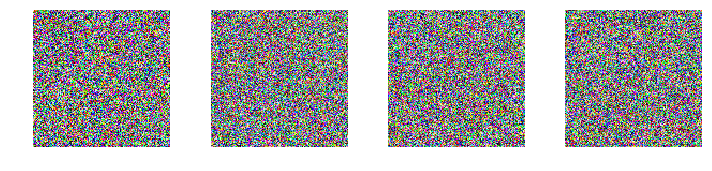

epoch: 100, [Discriminator :: d_loss: 0.196183], [ Generator :: loss: 2.404341]


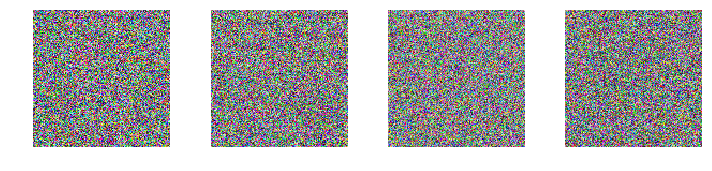

epoch: 200, [Discriminator :: d_loss: 0.040202], [ Generator :: loss: 3.552200]


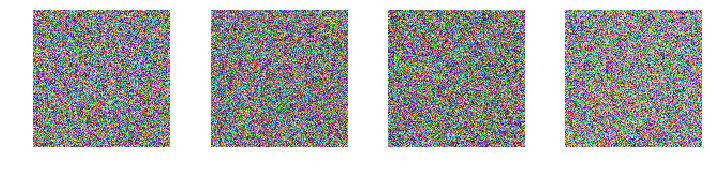

epoch: 300, [Discriminator :: d_loss: 0.060291], [ Generator :: loss: 4.468327]


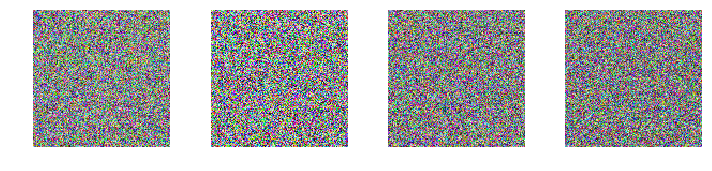

epoch: 400, [Discriminator :: d_loss: 0.043240], [ Generator :: loss: 5.600718]


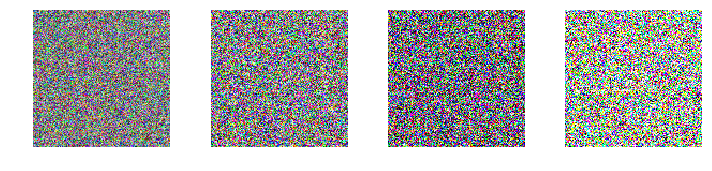

epoch: 500, [Discriminator :: d_loss: 0.150336], [ Generator :: loss: 6.579360]


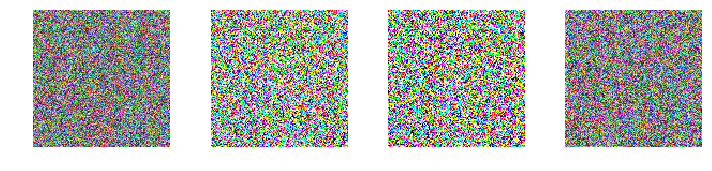

epoch: 600, [Discriminator :: d_loss: 0.104682], [ Generator :: loss: 6.127314]


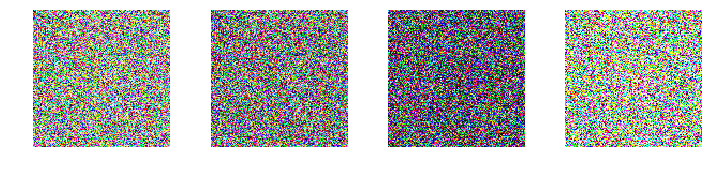

epoch: 700, [Discriminator :: d_loss: 0.074088], [ Generator :: loss: 4.989647]


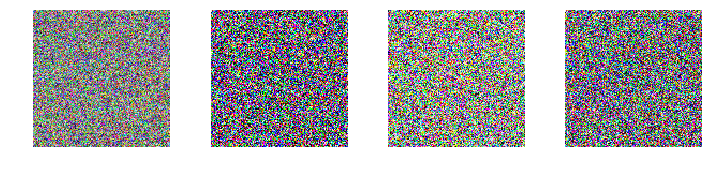

epoch: 800, [Discriminator :: d_loss: 0.021512], [ Generator :: loss: 9.876495]


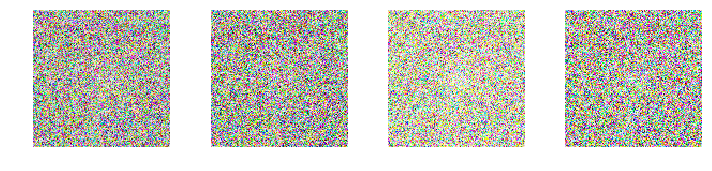

epoch: 900, [Discriminator :: d_loss: 0.122487], [ Generator :: loss: 8.259590]


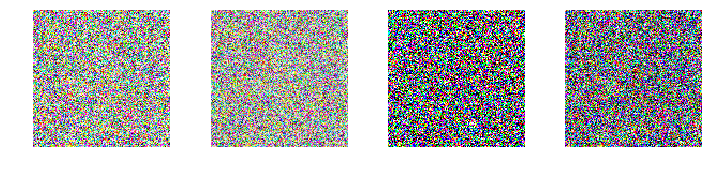

epoch: 999, [Discriminator :: d_loss: 0.182051], [ Generator :: loss: 12.520266]


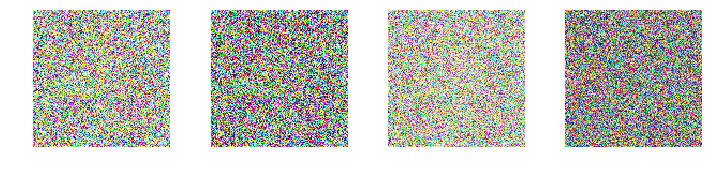

In [52]:
gan = GAN()

epoch: 0, [Discriminator :: d_loss: 0.082473], [ Generator :: loss: 11.571007]


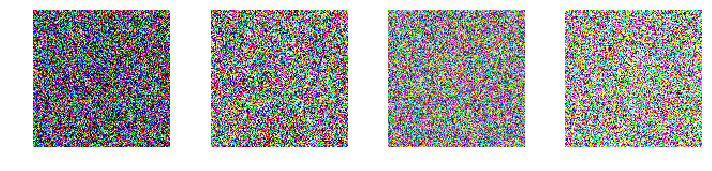

epoch: 100, [Discriminator :: d_loss: 0.232591], [ Generator :: loss: 8.941851]


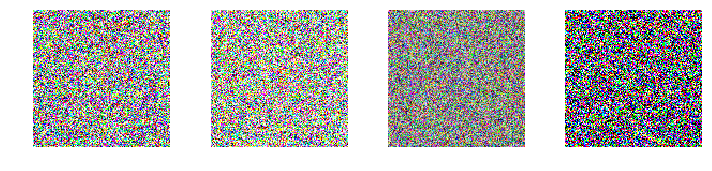

epoch: 200, [Discriminator :: d_loss: 0.078846], [ Generator :: loss: 5.611777]


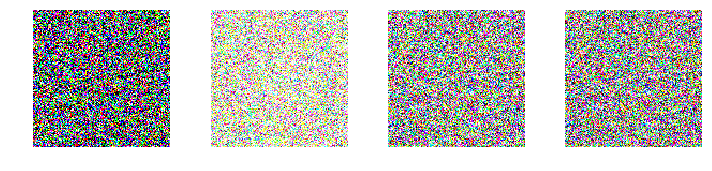

epoch: 300, [Discriminator :: d_loss: 0.094870], [ Generator :: loss: 11.595188]


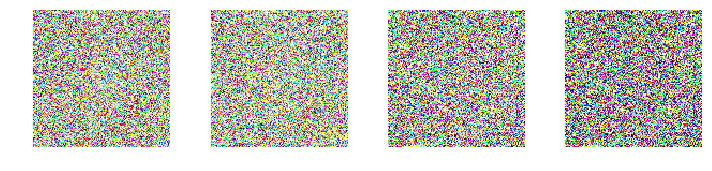

epoch: 400, [Discriminator :: d_loss: 0.197144], [ Generator :: loss: 12.336653]


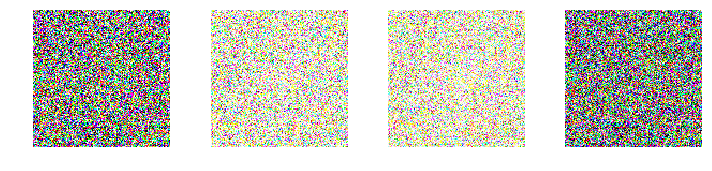

epoch: 500, [Discriminator :: d_loss: 0.071292], [ Generator :: loss: 5.910604]


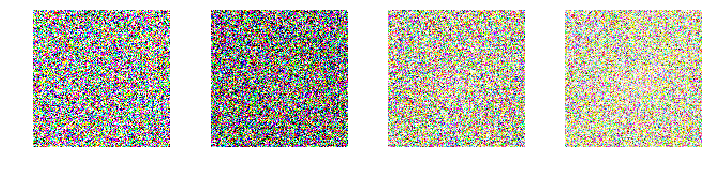

epoch: 600, [Discriminator :: d_loss: 0.090127], [ Generator :: loss: 5.495854]


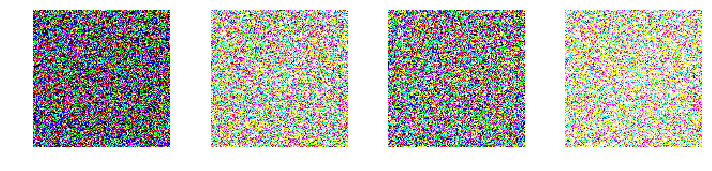

epoch: 700, [Discriminator :: d_loss: 0.149840], [ Generator :: loss: 8.610013]


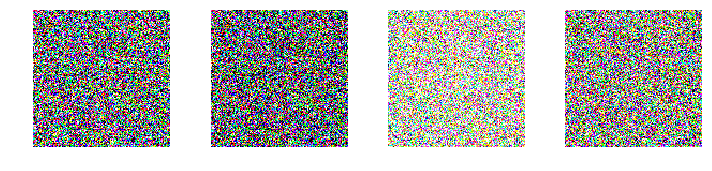

epoch: 800, [Discriminator :: d_loss: 0.129974], [ Generator :: loss: 6.841045]


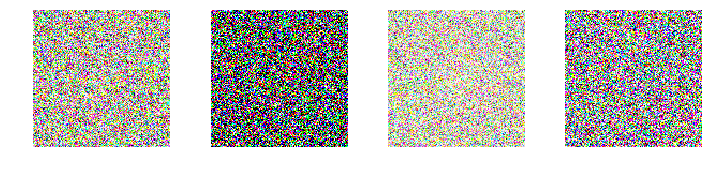

epoch: 900, [Discriminator :: d_loss: 0.174058], [ Generator :: loss: 3.414755]


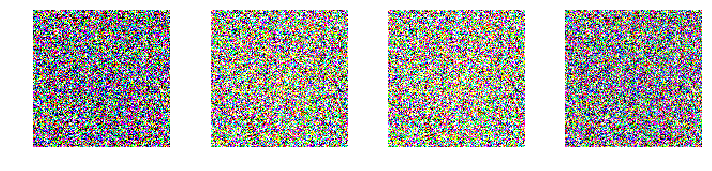

epoch: 1000, [Discriminator :: d_loss: 0.225088], [ Generator :: loss: 8.415763]


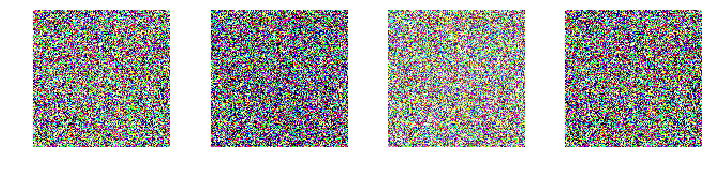

epoch: 1100, [Discriminator :: d_loss: 0.171094], [ Generator :: loss: 6.682930]


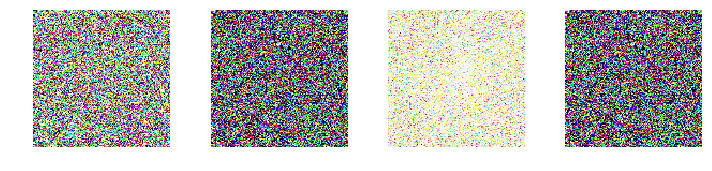

epoch: 1200, [Discriminator :: d_loss: 0.112910], [ Generator :: loss: 6.416432]


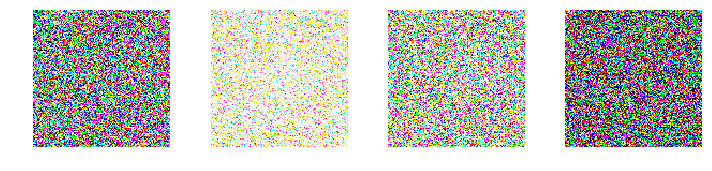

epoch: 1300, [Discriminator :: d_loss: 0.266649], [ Generator :: loss: 7.023646]


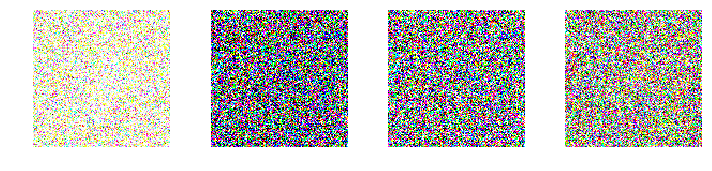

epoch: 1400, [Discriminator :: d_loss: 0.124944], [ Generator :: loss: 4.552115]


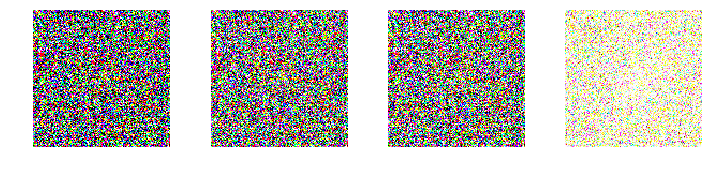

epoch: 1500, [Discriminator :: d_loss: 0.095930], [ Generator :: loss: 4.767583]


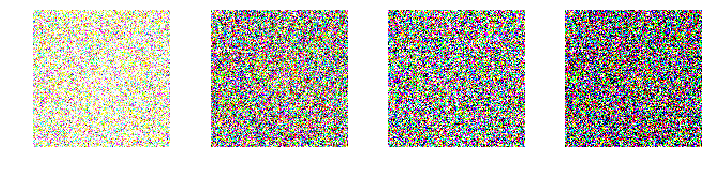

epoch: 1600, [Discriminator :: d_loss: 0.311532], [ Generator :: loss: 4.573520]


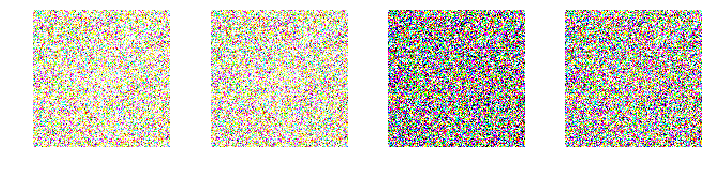

epoch: 1700, [Discriminator :: d_loss: 0.109344], [ Generator :: loss: 3.763123]


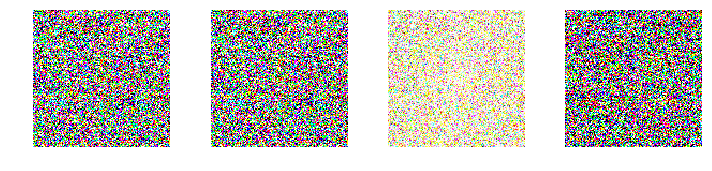

epoch: 1800, [Discriminator :: d_loss: 0.181976], [ Generator :: loss: 6.866651]


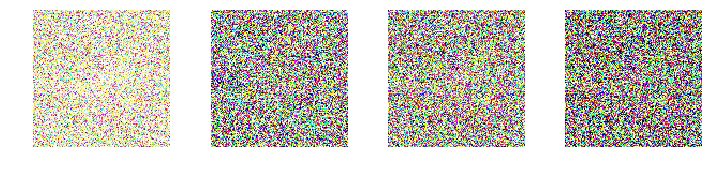

epoch: 1900, [Discriminator :: d_loss: 0.465745], [ Generator :: loss: 5.612980]


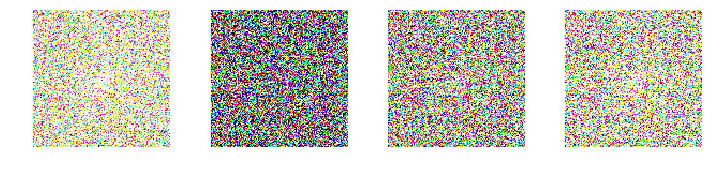

epoch: 2000, [Discriminator :: d_loss: 0.281040], [ Generator :: loss: 4.331849]


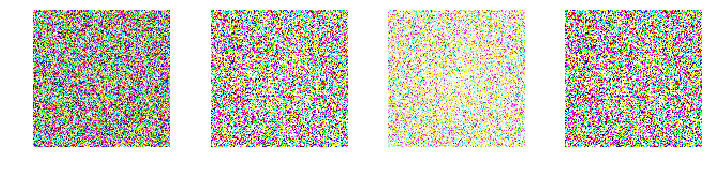

epoch: 2100, [Discriminator :: d_loss: 0.199055], [ Generator :: loss: 5.683520]


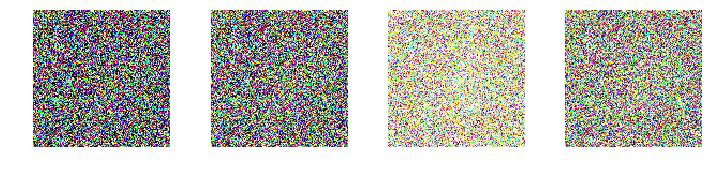

epoch: 2200, [Discriminator :: d_loss: 0.531517], [ Generator :: loss: 4.952946]


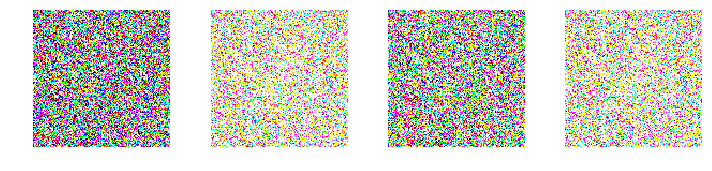

epoch: 2300, [Discriminator :: d_loss: 0.719297], [ Generator :: loss: 8.034770]


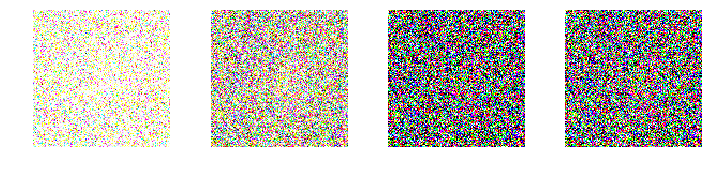

epoch: 2400, [Discriminator :: d_loss: 0.300129], [ Generator :: loss: 6.756313]


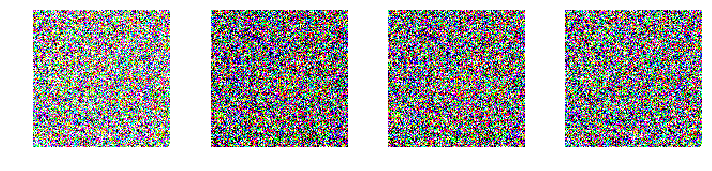

epoch: 2500, [Discriminator :: d_loss: 0.457174], [ Generator :: loss: 8.295899]


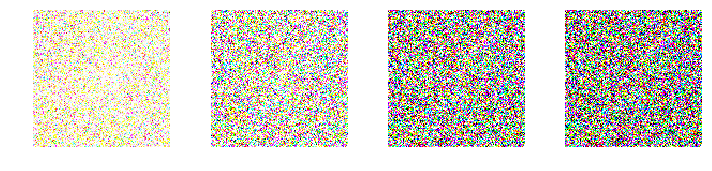

epoch: 2600, [Discriminator :: d_loss: 0.171211], [ Generator :: loss: 8.047901]


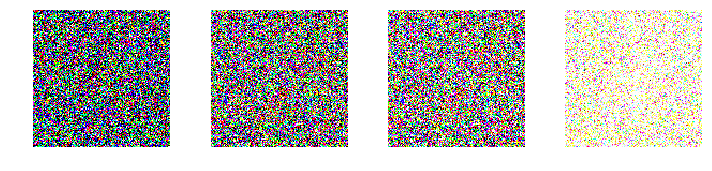

epoch: 2700, [Discriminator :: d_loss: 0.246042], [ Generator :: loss: 7.145333]


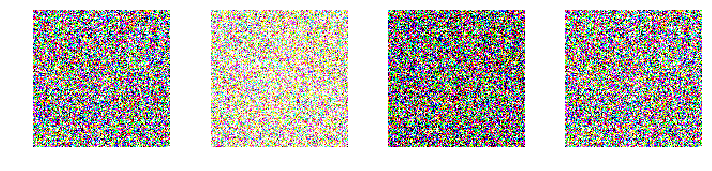

epoch: 2800, [Discriminator :: d_loss: 0.044879], [ Generator :: loss: 9.003870]


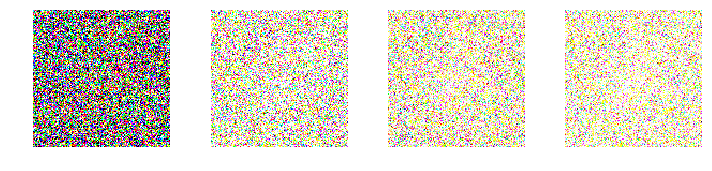

epoch: 2900, [Discriminator :: d_loss: 0.107926], [ Generator :: loss: 6.922533]


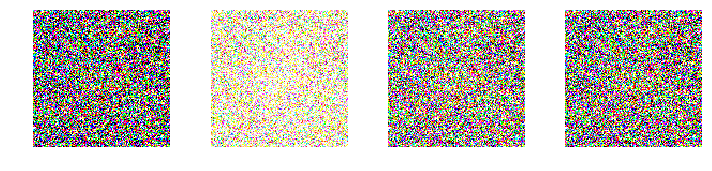

epoch: 3000, [Discriminator :: d_loss: 0.111427], [ Generator :: loss: 5.832018]


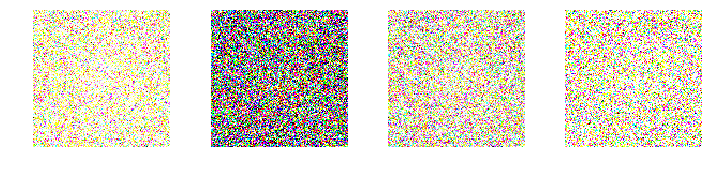

epoch: 3100, [Discriminator :: d_loss: 0.143533], [ Generator :: loss: 7.507525]


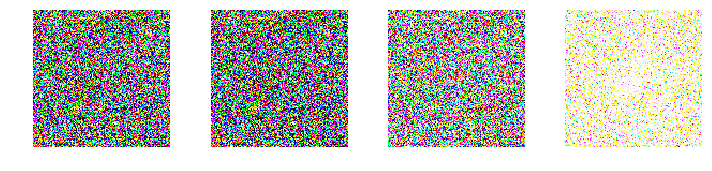

epoch: 3200, [Discriminator :: d_loss: 0.281607], [ Generator :: loss: 5.871813]


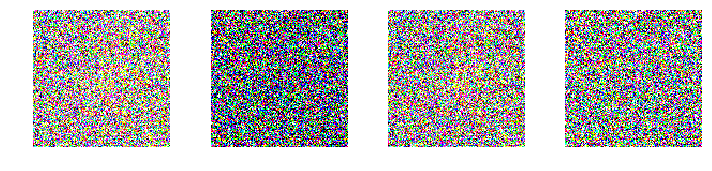

epoch: 3300, [Discriminator :: d_loss: 0.416684], [ Generator :: loss: 5.917549]


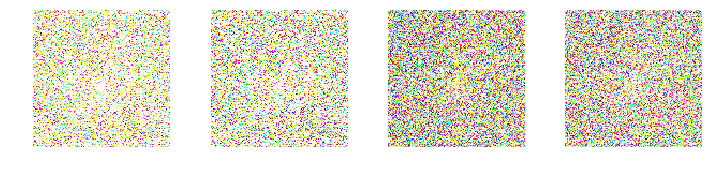

epoch: 3400, [Discriminator :: d_loss: 0.328966], [ Generator :: loss: 8.291132]


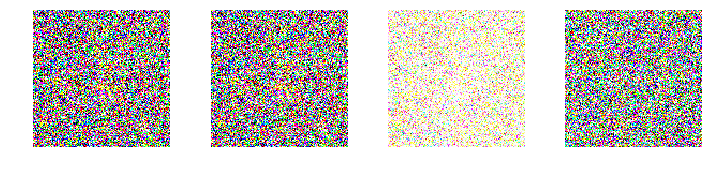

epoch: 3500, [Discriminator :: d_loss: 0.357564], [ Generator :: loss: 4.636112]


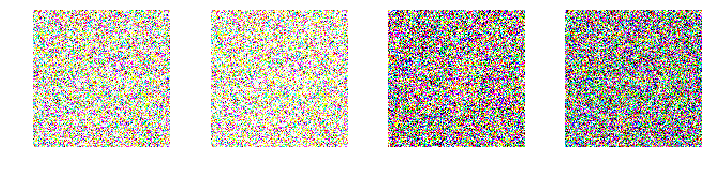

epoch: 3600, [Discriminator :: d_loss: 0.375475], [ Generator :: loss: 6.059749]


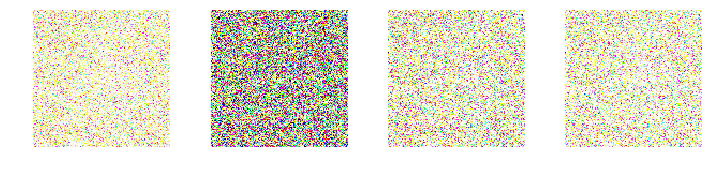

epoch: 3700, [Discriminator :: d_loss: 0.243510], [ Generator :: loss: 4.795665]


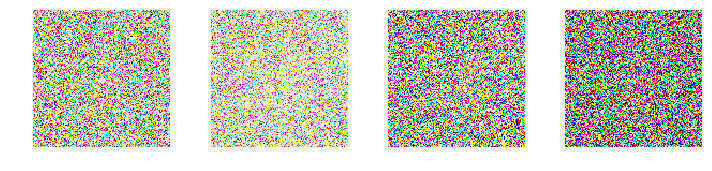

epoch: 3800, [Discriminator :: d_loss: 0.204395], [ Generator :: loss: 4.509798]


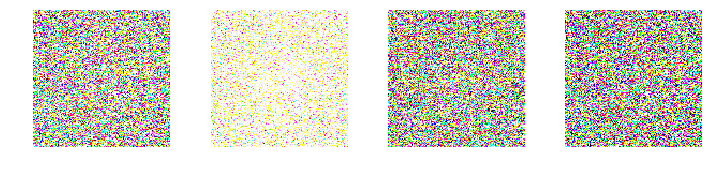

epoch: 3900, [Discriminator :: d_loss: 0.227466], [ Generator :: loss: 3.964651]


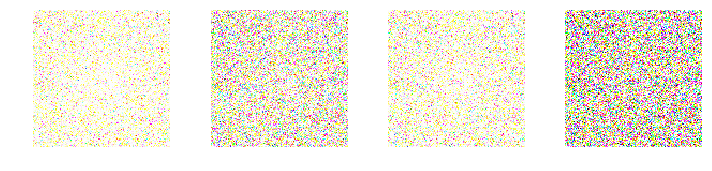

epoch: 4000, [Discriminator :: d_loss: 0.374762], [ Generator :: loss: 4.074712]


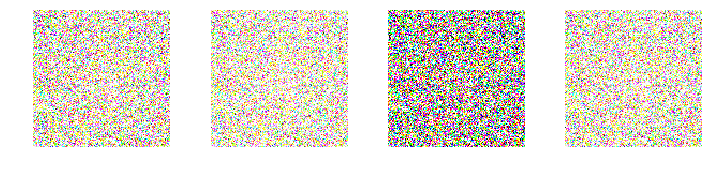

epoch: 4100, [Discriminator :: d_loss: 0.282738], [ Generator :: loss: 5.215347]


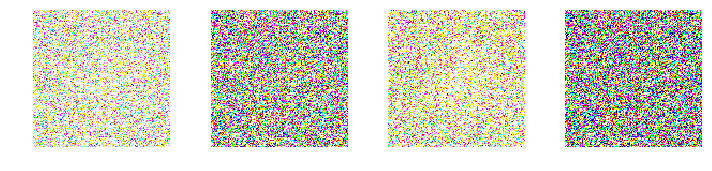

epoch: 4200, [Discriminator :: d_loss: 0.250959], [ Generator :: loss: 6.810997]


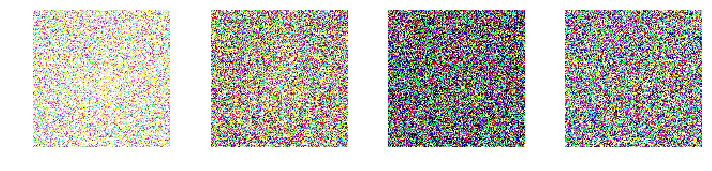

epoch: 4300, [Discriminator :: d_loss: 0.330502], [ Generator :: loss: 4.593822]


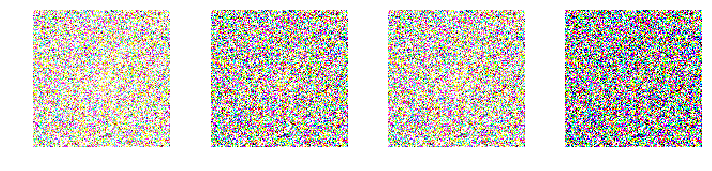

epoch: 4400, [Discriminator :: d_loss: 0.108959], [ Generator :: loss: 3.173786]


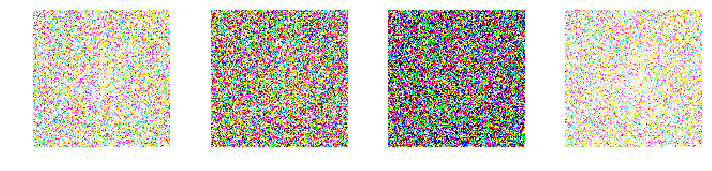

epoch: 4500, [Discriminator :: d_loss: 0.086904], [ Generator :: loss: 3.971960]


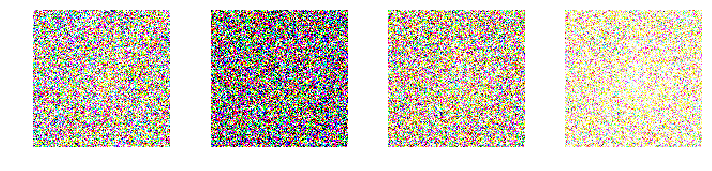

epoch: 4600, [Discriminator :: d_loss: 0.115511], [ Generator :: loss: 3.656563]


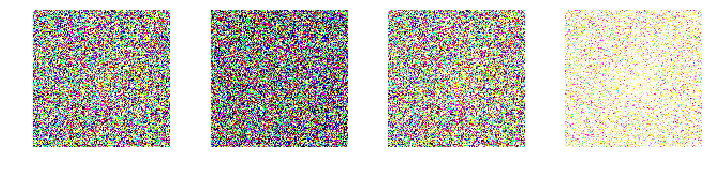

epoch: 4700, [Discriminator :: d_loss: 0.220829], [ Generator :: loss: 5.908762]


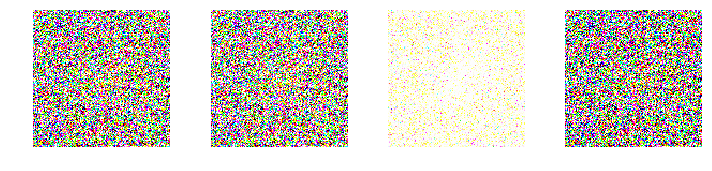

epoch: 4800, [Discriminator :: d_loss: 0.345798], [ Generator :: loss: 10.211039]


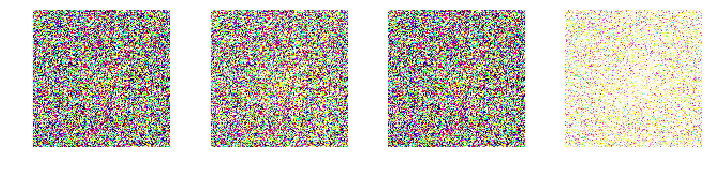

epoch: 4900, [Discriminator :: d_loss: 0.313465], [ Generator :: loss: 3.876647]


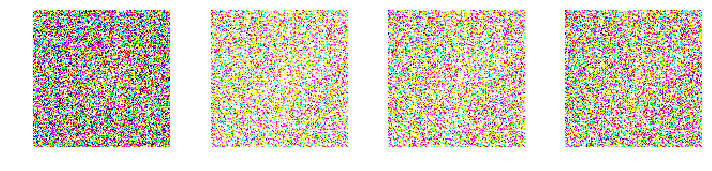

epoch: 5000, [Discriminator :: d_loss: 0.122307], [ Generator :: loss: 6.816360]


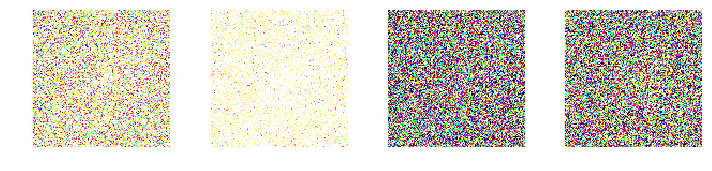

epoch: 5100, [Discriminator :: d_loss: 0.179122], [ Generator :: loss: 3.629338]


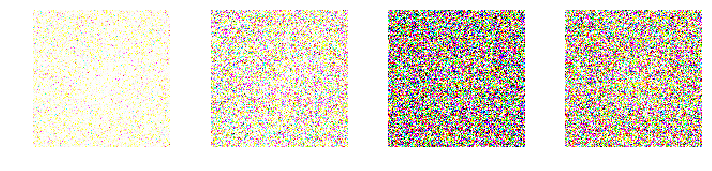

epoch: 5200, [Discriminator :: d_loss: 0.246990], [ Generator :: loss: 3.858012]


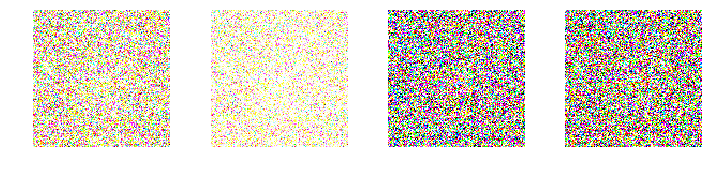

epoch: 5300, [Discriminator :: d_loss: 0.154477], [ Generator :: loss: 5.066099]


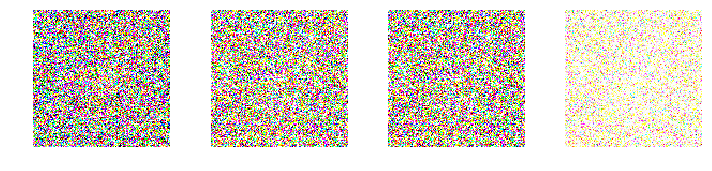

epoch: 5400, [Discriminator :: d_loss: 0.225085], [ Generator :: loss: 5.703702]


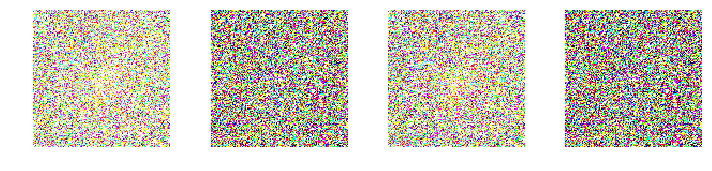

epoch: 5500, [Discriminator :: d_loss: 0.755103], [ Generator :: loss: 3.568395]


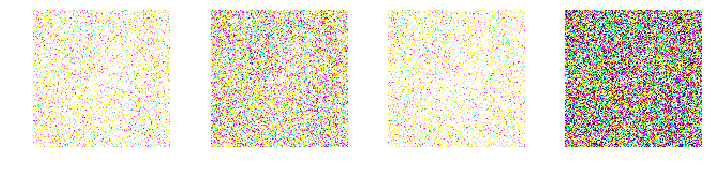

epoch: 5600, [Discriminator :: d_loss: 0.335911], [ Generator :: loss: 3.978414]


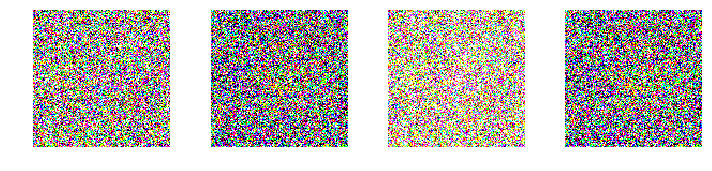

epoch: 5700, [Discriminator :: d_loss: 0.330330], [ Generator :: loss: 5.987777]


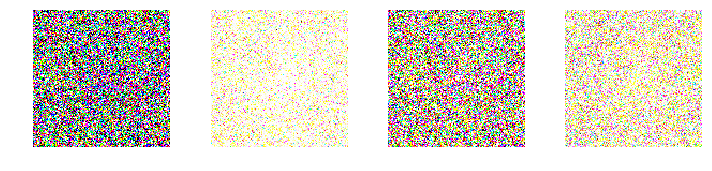

epoch: 5800, [Discriminator :: d_loss: 0.242590], [ Generator :: loss: 5.161981]


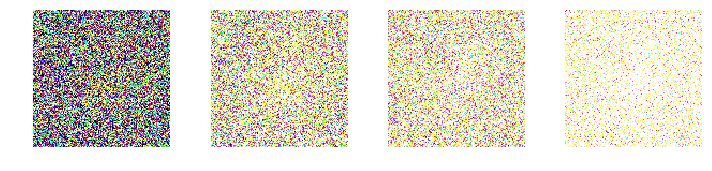

epoch: 5900, [Discriminator :: d_loss: 0.264460], [ Generator :: loss: 4.599968]


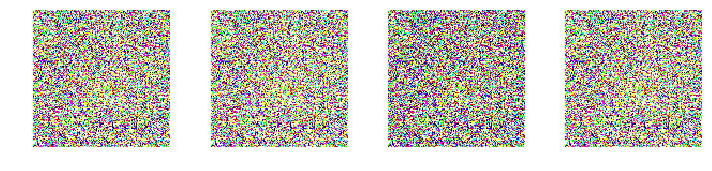

epoch: 6000, [Discriminator :: d_loss: 0.259197], [ Generator :: loss: 4.083072]


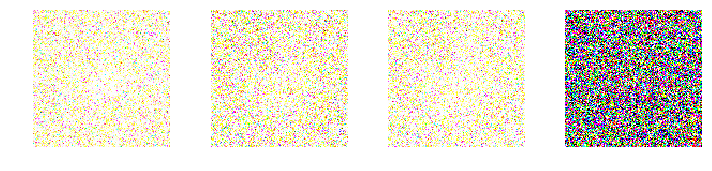

epoch: 6100, [Discriminator :: d_loss: 0.184123], [ Generator :: loss: 4.555252]


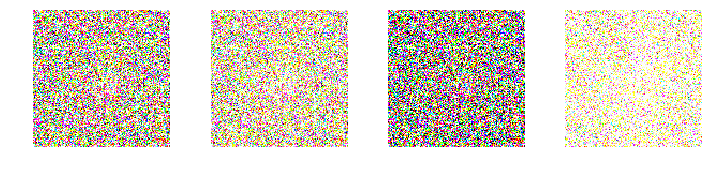

epoch: 6200, [Discriminator :: d_loss: 0.564427], [ Generator :: loss: 4.185925]


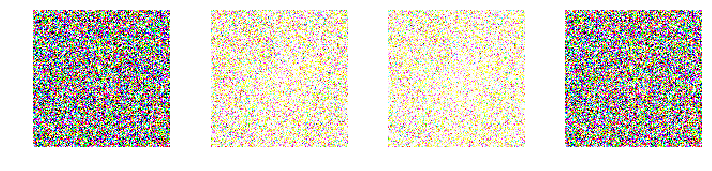

epoch: 6300, [Discriminator :: d_loss: 0.248285], [ Generator :: loss: 5.341630]


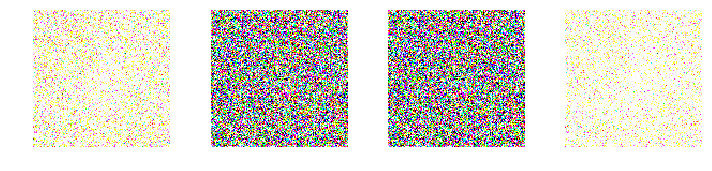

epoch: 6400, [Discriminator :: d_loss: 0.402719], [ Generator :: loss: 3.785216]


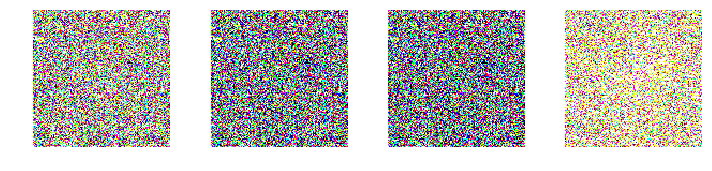

epoch: 6500, [Discriminator :: d_loss: 0.325710], [ Generator :: loss: 6.174114]


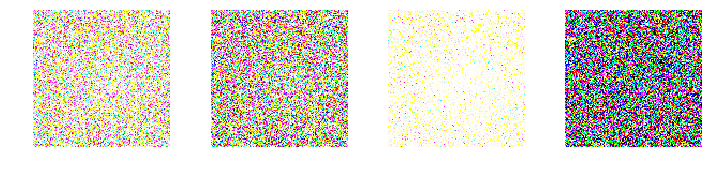

epoch: 6600, [Discriminator :: d_loss: 0.200660], [ Generator :: loss: 5.847099]


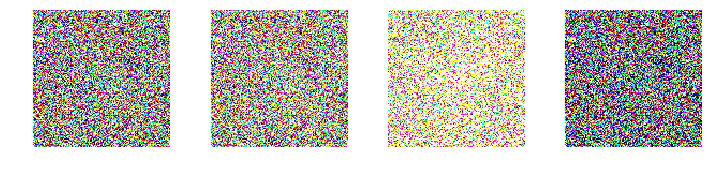

epoch: 6700, [Discriminator :: d_loss: 0.196277], [ Generator :: loss: 9.611332]


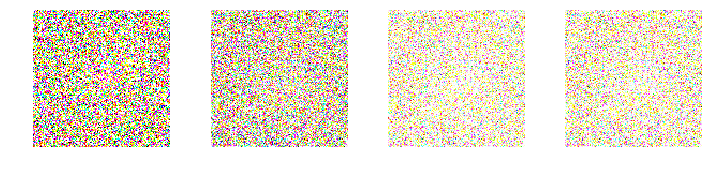

epoch: 6800, [Discriminator :: d_loss: 0.134029], [ Generator :: loss: 3.774396]


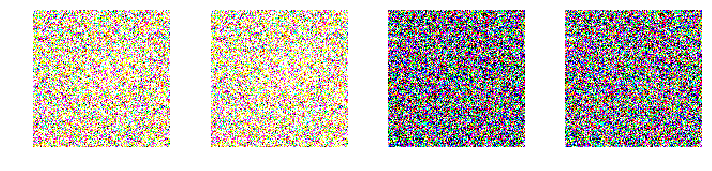

epoch: 6900, [Discriminator :: d_loss: 0.285265], [ Generator :: loss: 4.438014]


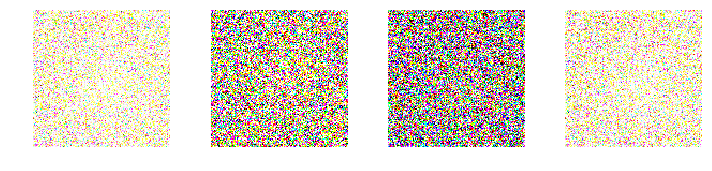

epoch: 7000, [Discriminator :: d_loss: 0.255183], [ Generator :: loss: 4.757878]


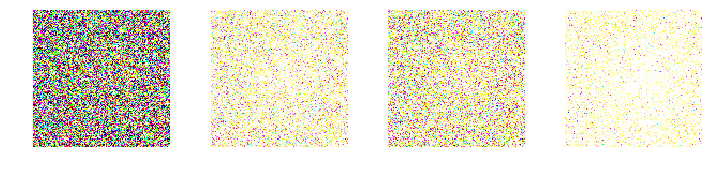

epoch: 7100, [Discriminator :: d_loss: 0.268079], [ Generator :: loss: 2.976645]


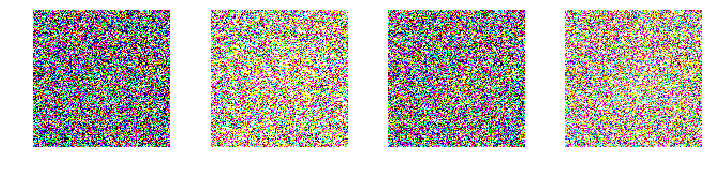

epoch: 7200, [Discriminator :: d_loss: 0.389268], [ Generator :: loss: 4.950034]


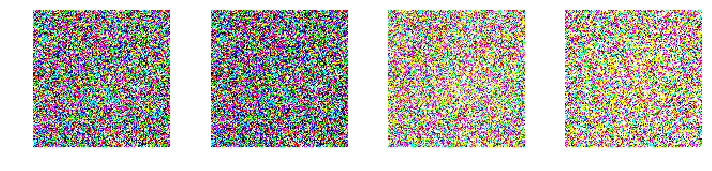

epoch: 7300, [Discriminator :: d_loss: 0.160081], [ Generator :: loss: 4.016427]


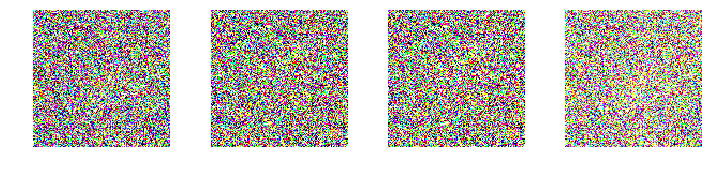

epoch: 7400, [Discriminator :: d_loss: 0.099824], [ Generator :: loss: 4.497462]


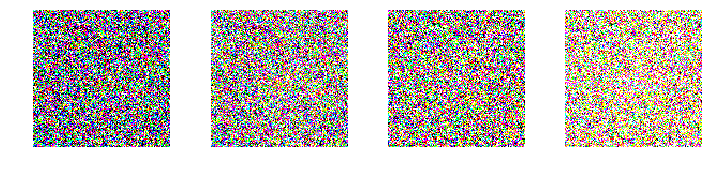

epoch: 7500, [Discriminator :: d_loss: 0.110790], [ Generator :: loss: 5.103672]


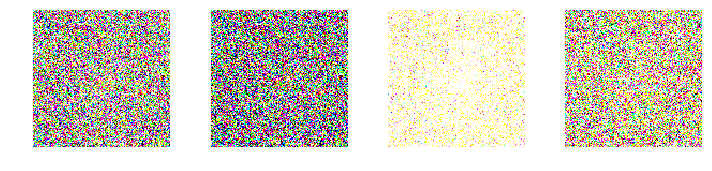

epoch: 7600, [Discriminator :: d_loss: 0.255752], [ Generator :: loss: 7.392111]


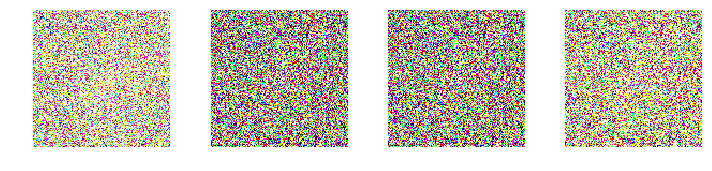

epoch: 7700, [Discriminator :: d_loss: 0.134056], [ Generator :: loss: 3.121017]


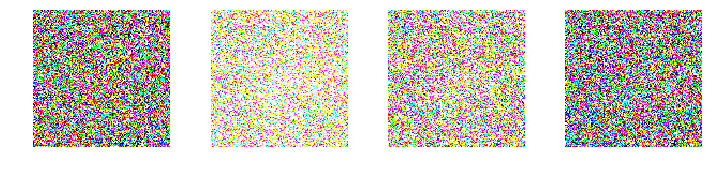

epoch: 7800, [Discriminator :: d_loss: 0.173229], [ Generator :: loss: 4.218990]


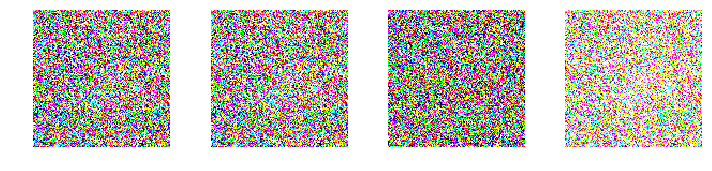

epoch: 7900, [Discriminator :: d_loss: 0.099854], [ Generator :: loss: 3.536662]


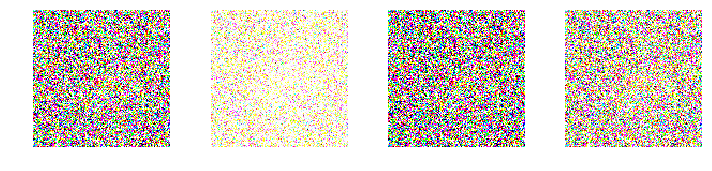

epoch: 8000, [Discriminator :: d_loss: 0.075421], [ Generator :: loss: 5.434141]


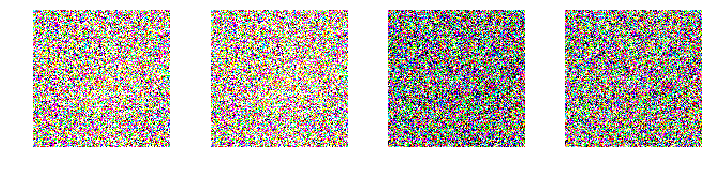

epoch: 8100, [Discriminator :: d_loss: 0.379262], [ Generator :: loss: 6.405672]


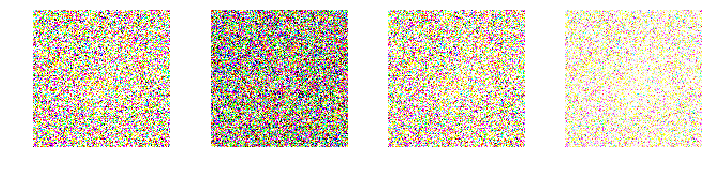

epoch: 8200, [Discriminator :: d_loss: 0.313722], [ Generator :: loss: 6.153435]


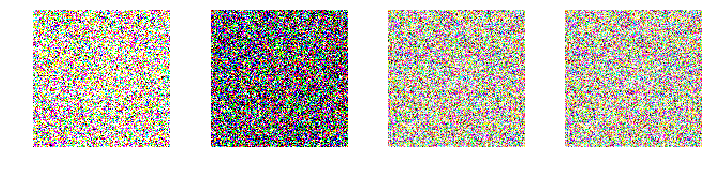

epoch: 8300, [Discriminator :: d_loss: 0.199085], [ Generator :: loss: 4.804469]


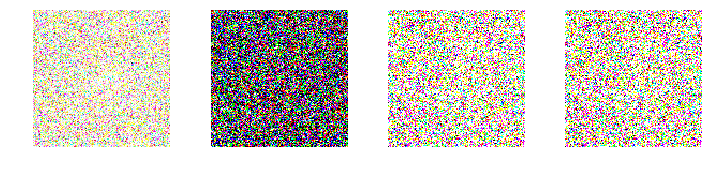

epoch: 8400, [Discriminator :: d_loss: 0.161877], [ Generator :: loss: 1.994949]


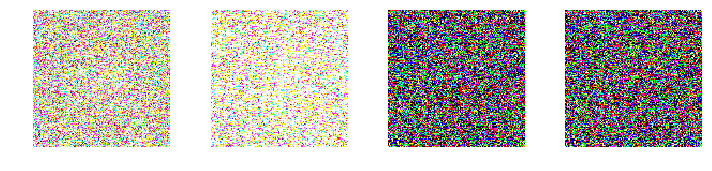

epoch: 8500, [Discriminator :: d_loss: 0.425467], [ Generator :: loss: 5.036539]


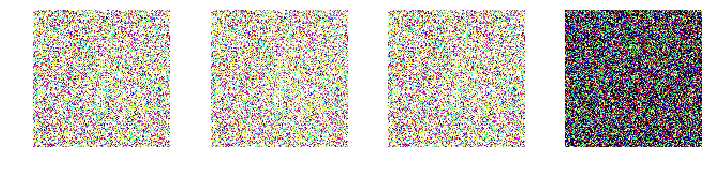

epoch: 8600, [Discriminator :: d_loss: 0.523735], [ Generator :: loss: 4.937107]


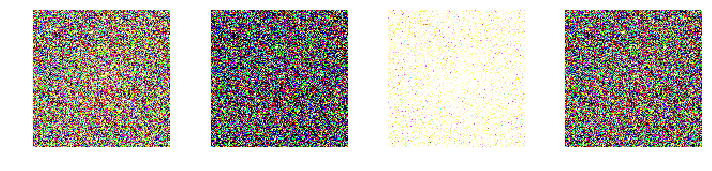

epoch: 8700, [Discriminator :: d_loss: 0.239470], [ Generator :: loss: 4.272174]


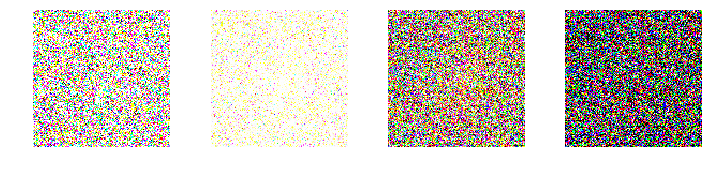

epoch: 8800, [Discriminator :: d_loss: 0.129264], [ Generator :: loss: 5.066520]


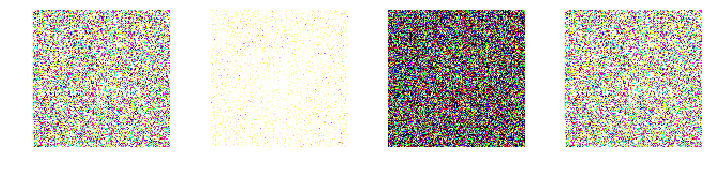

epoch: 8900, [Discriminator :: d_loss: 0.277463], [ Generator :: loss: 5.030310]


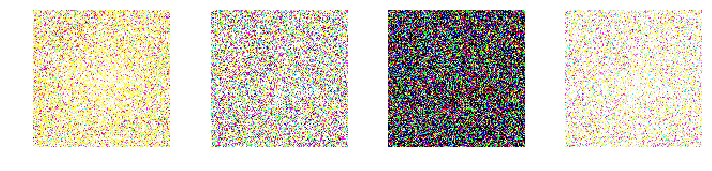

epoch: 9000, [Discriminator :: d_loss: 0.355130], [ Generator :: loss: 5.442244]


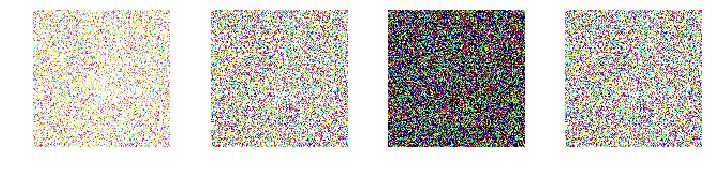

epoch: 9100, [Discriminator :: d_loss: 0.318034], [ Generator :: loss: 2.015204]


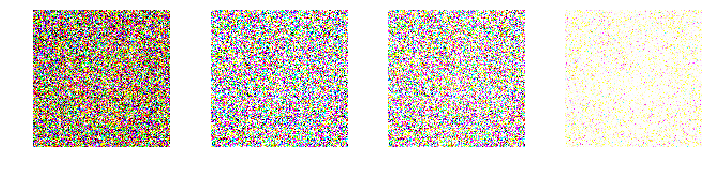

epoch: 9200, [Discriminator :: d_loss: 0.235278], [ Generator :: loss: 3.946087]


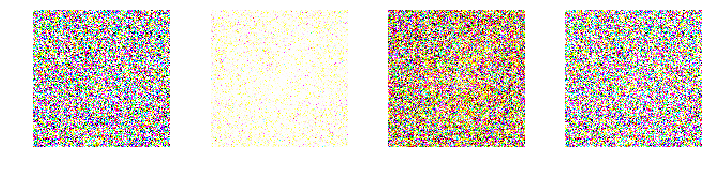

epoch: 9300, [Discriminator :: d_loss: 0.284135], [ Generator :: loss: 2.659258]


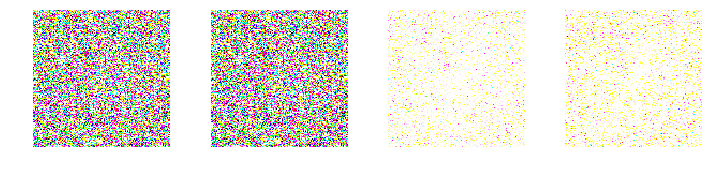

epoch: 9400, [Discriminator :: d_loss: 0.177085], [ Generator :: loss: 3.247030]


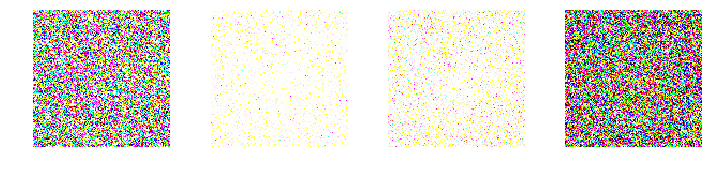

epoch: 9500, [Discriminator :: d_loss: 0.192720], [ Generator :: loss: 5.400741]


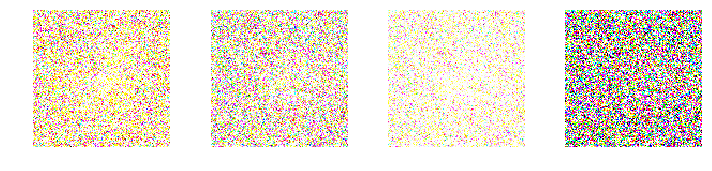

epoch: 9600, [Discriminator :: d_loss: 0.251318], [ Generator :: loss: 4.761727]


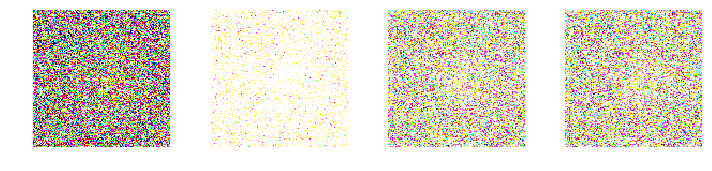

epoch: 9700, [Discriminator :: d_loss: 0.168587], [ Generator :: loss: 5.289420]


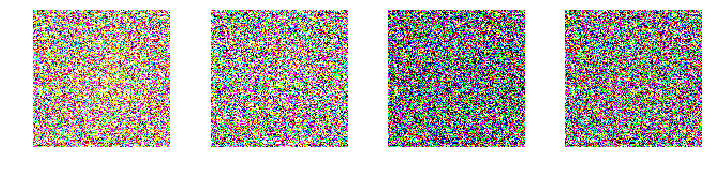

epoch: 9800, [Discriminator :: d_loss: 0.237000], [ Generator :: loss: 3.213993]


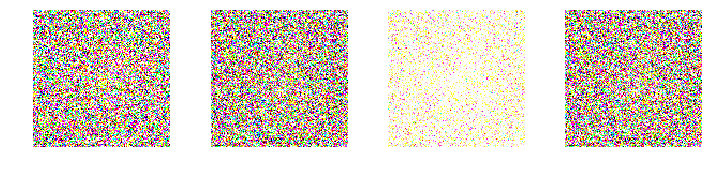

epoch: 9900, [Discriminator :: d_loss: 0.759277], [ Generator :: loss: 6.140121]


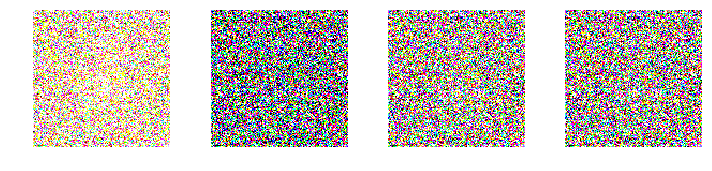

epoch: 10000, [Discriminator :: d_loss: 0.343005], [ Generator :: loss: 4.210080]


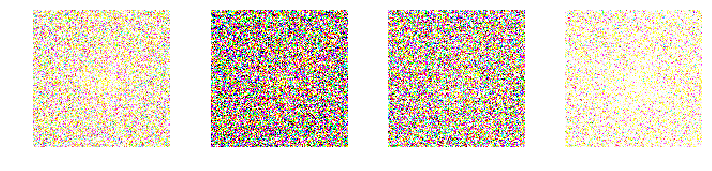

epoch: 10100, [Discriminator :: d_loss: 0.530603], [ Generator :: loss: 2.682188]


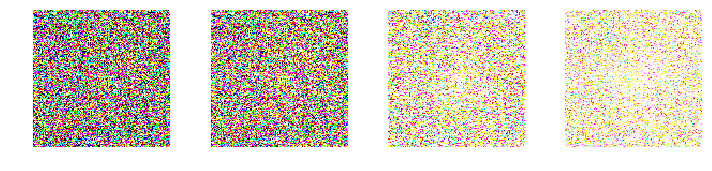

epoch: 10200, [Discriminator :: d_loss: 0.270450], [ Generator :: loss: 5.450259]


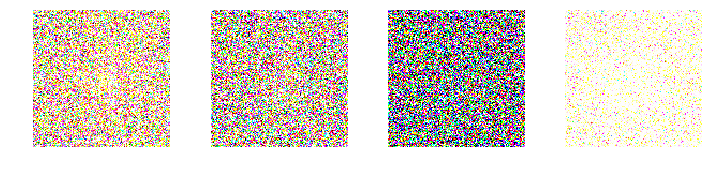

epoch: 10300, [Discriminator :: d_loss: 0.098114], [ Generator :: loss: 5.180283]


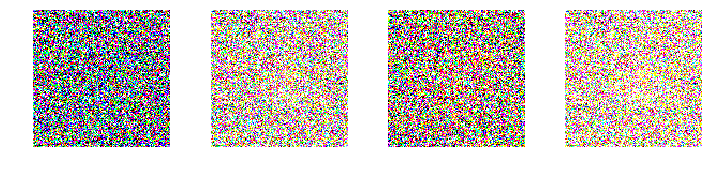

epoch: 10400, [Discriminator :: d_loss: 0.233181], [ Generator :: loss: 3.665084]


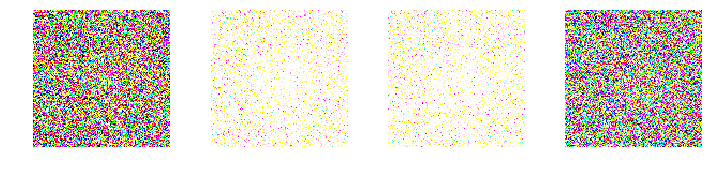

epoch: 10500, [Discriminator :: d_loss: 0.332351], [ Generator :: loss: 6.149891]


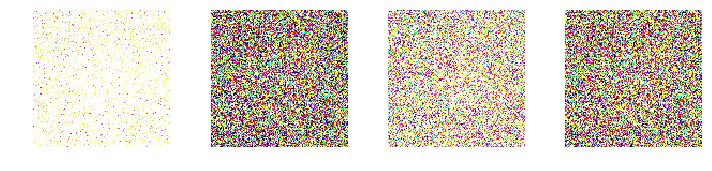

epoch: 10600, [Discriminator :: d_loss: 0.179552], [ Generator :: loss: 3.886825]


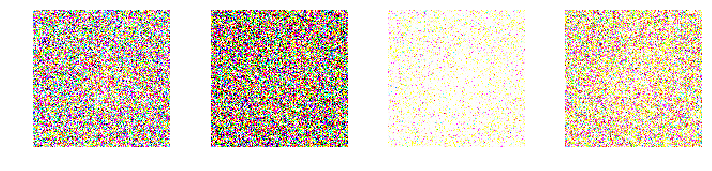

epoch: 10700, [Discriminator :: d_loss: 0.240154], [ Generator :: loss: 3.916319]


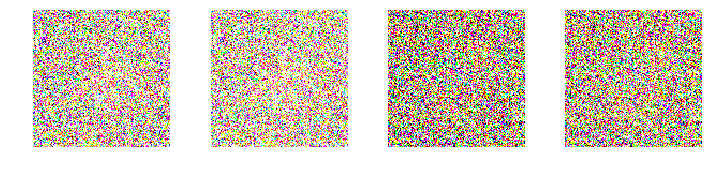

epoch: 10800, [Discriminator :: d_loss: 0.155222], [ Generator :: loss: 6.092948]


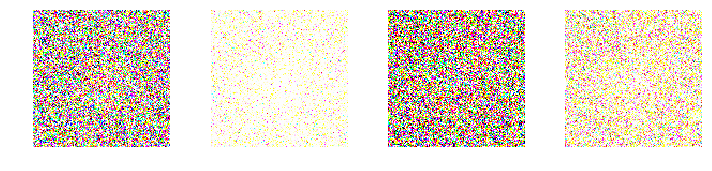

epoch: 10900, [Discriminator :: d_loss: 0.409606], [ Generator :: loss: 4.680259]


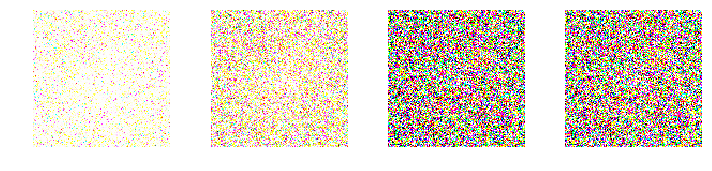

epoch: 11000, [Discriminator :: d_loss: 0.235308], [ Generator :: loss: 6.173093]


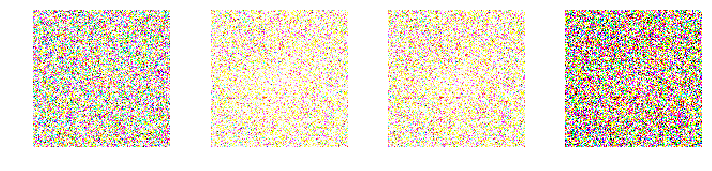

epoch: 11100, [Discriminator :: d_loss: 0.312956], [ Generator :: loss: 6.058739]


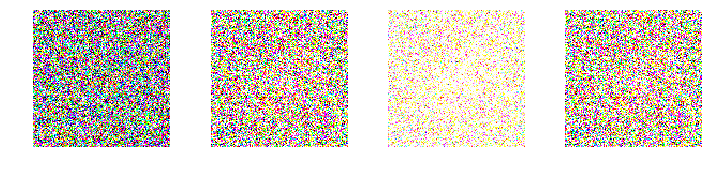

epoch: 11200, [Discriminator :: d_loss: 0.175190], [ Generator :: loss: 3.876752]


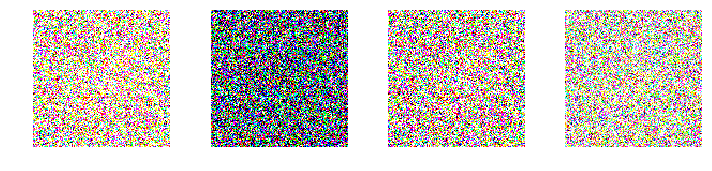

epoch: 11300, [Discriminator :: d_loss: 0.157659], [ Generator :: loss: 6.828435]


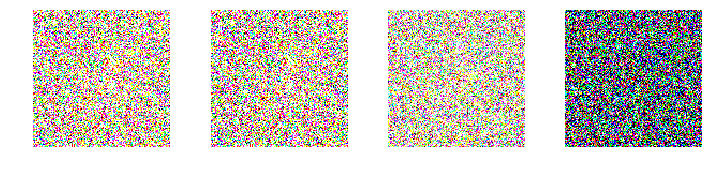

epoch: 11400, [Discriminator :: d_loss: 0.117440], [ Generator :: loss: 7.338629]


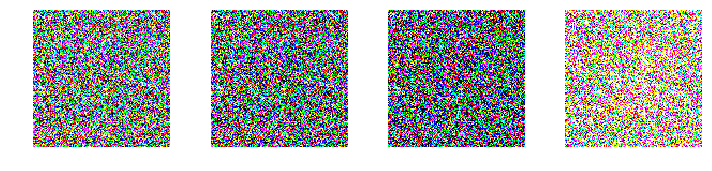

epoch: 11500, [Discriminator :: d_loss: 0.127623], [ Generator :: loss: 3.177654]


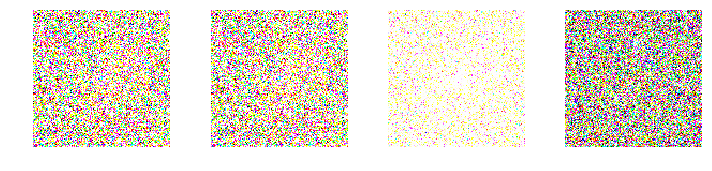

epoch: 11600, [Discriminator :: d_loss: 0.153585], [ Generator :: loss: 3.881839]


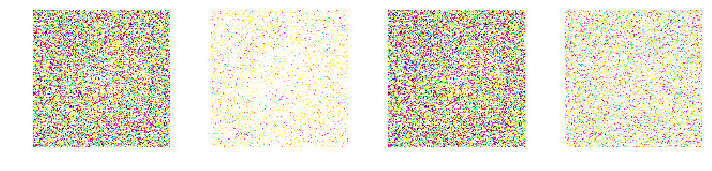

epoch: 11700, [Discriminator :: d_loss: 0.155549], [ Generator :: loss: 5.347934]


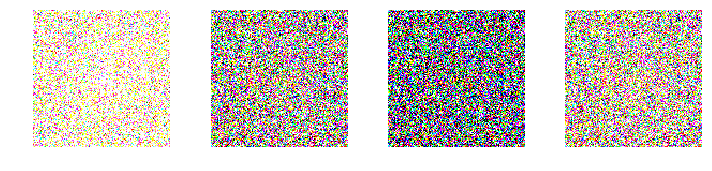

epoch: 11800, [Discriminator :: d_loss: 0.149980], [ Generator :: loss: 8.736883]


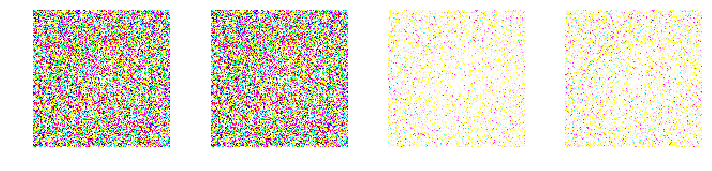

epoch: 11900, [Discriminator :: d_loss: 0.135909], [ Generator :: loss: 5.157459]


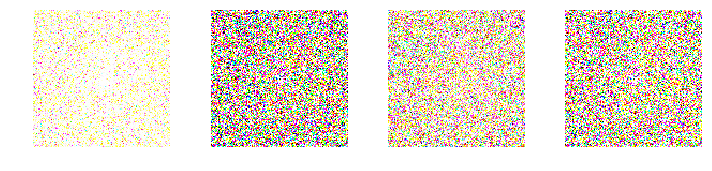

epoch: 12000, [Discriminator :: d_loss: 0.077296], [ Generator :: loss: 4.375882]


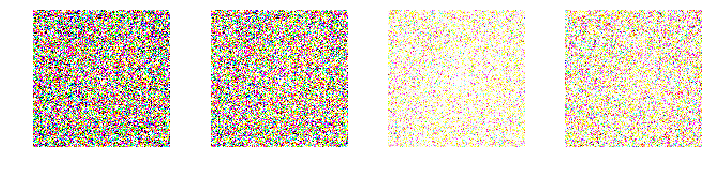

epoch: 12100, [Discriminator :: d_loss: 0.155949], [ Generator :: loss: 6.176659]


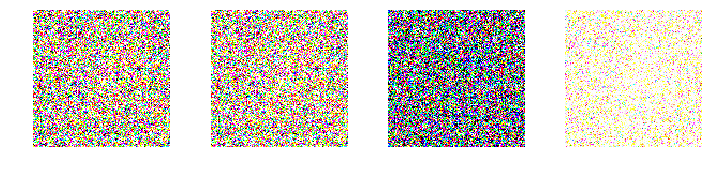

epoch: 12200, [Discriminator :: d_loss: 0.107285], [ Generator :: loss: 4.653874]


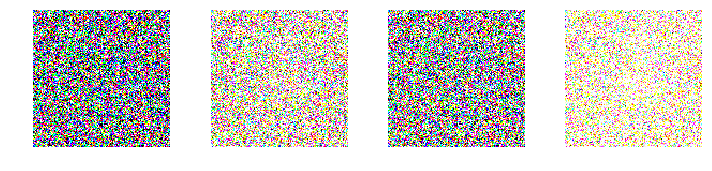

epoch: 12300, [Discriminator :: d_loss: 0.040642], [ Generator :: loss: 5.289088]


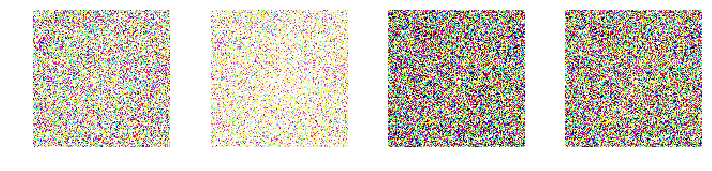

epoch: 12400, [Discriminator :: d_loss: 0.074010], [ Generator :: loss: 4.691567]


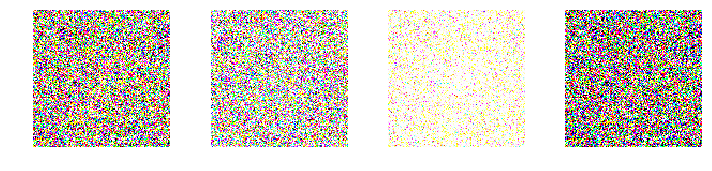

epoch: 12500, [Discriminator :: d_loss: 0.085825], [ Generator :: loss: 4.255891]


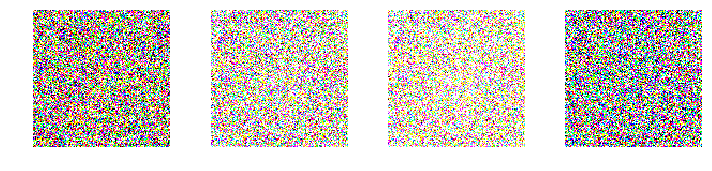

epoch: 12600, [Discriminator :: d_loss: 0.112027], [ Generator :: loss: 4.461084]


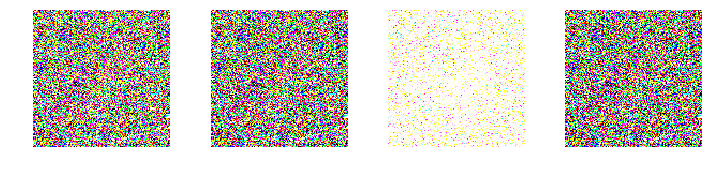

epoch: 12700, [Discriminator :: d_loss: 0.153644], [ Generator :: loss: 3.496537]


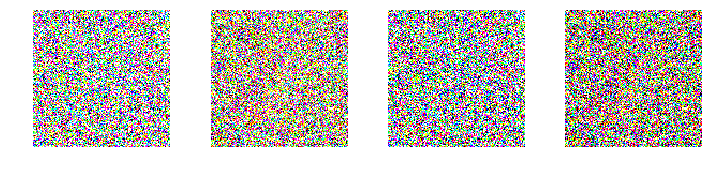

epoch: 12800, [Discriminator :: d_loss: 0.081670], [ Generator :: loss: 6.780391]


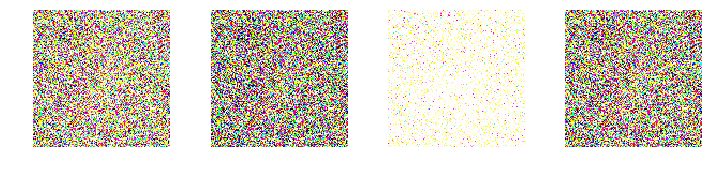

epoch: 12900, [Discriminator :: d_loss: 0.193500], [ Generator :: loss: 5.652270]


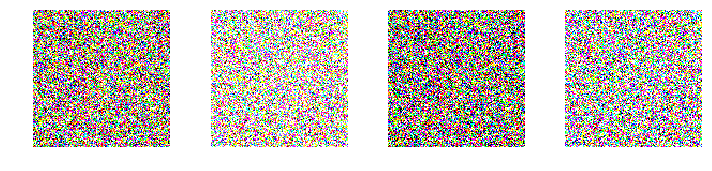

epoch: 13000, [Discriminator :: d_loss: 0.182613], [ Generator :: loss: 8.870371]


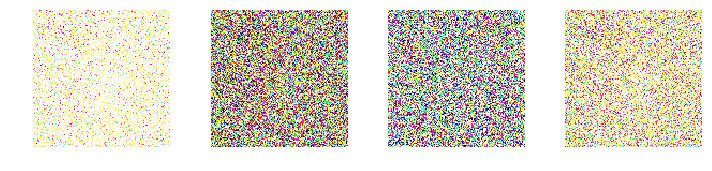

epoch: 13100, [Discriminator :: d_loss: 0.119760], [ Generator :: loss: 7.402511]


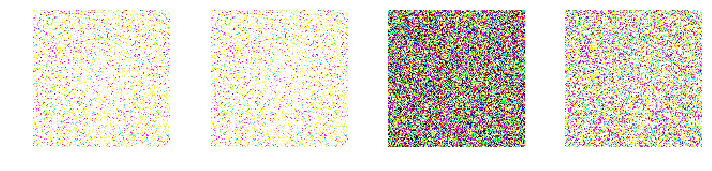

epoch: 13200, [Discriminator :: d_loss: 0.070831], [ Generator :: loss: 5.524150]


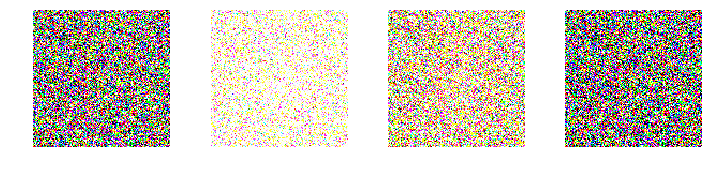

epoch: 13300, [Discriminator :: d_loss: 0.511878], [ Generator :: loss: 4.918050]


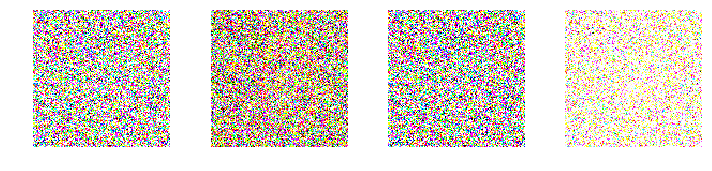

epoch: 13400, [Discriminator :: d_loss: 0.222402], [ Generator :: loss: 7.500904]


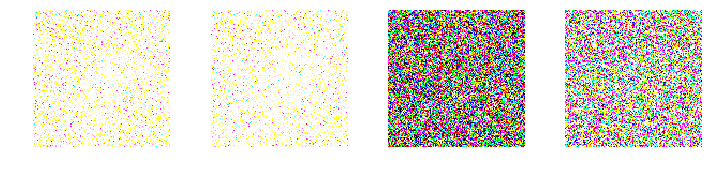

epoch: 13500, [Discriminator :: d_loss: 1.494898], [ Generator :: loss: 10.035862]


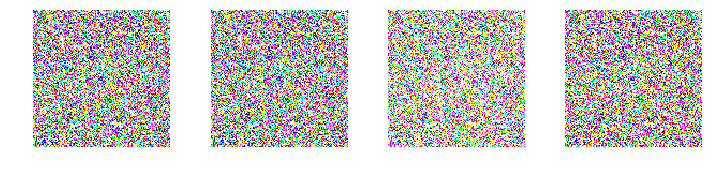

epoch: 13600, [Discriminator :: d_loss: 0.328849], [ Generator :: loss: 6.842486]


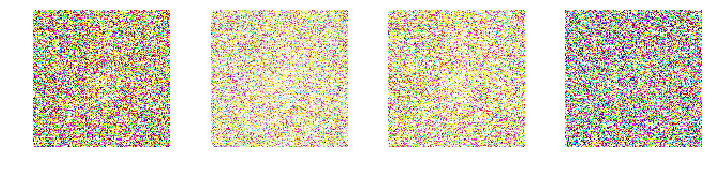

epoch: 13700, [Discriminator :: d_loss: 0.328530], [ Generator :: loss: 8.681942]


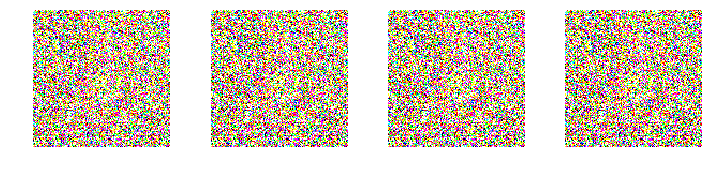

epoch: 13800, [Discriminator :: d_loss: 0.025610], [ Generator :: loss: 11.135707]


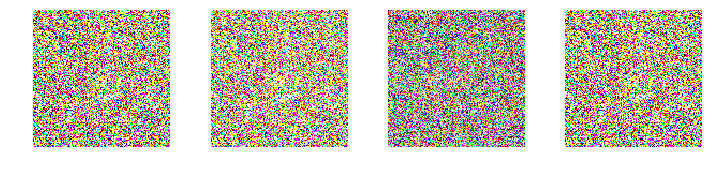

epoch: 13900, [Discriminator :: d_loss: 0.077786], [ Generator :: loss: 5.254738]


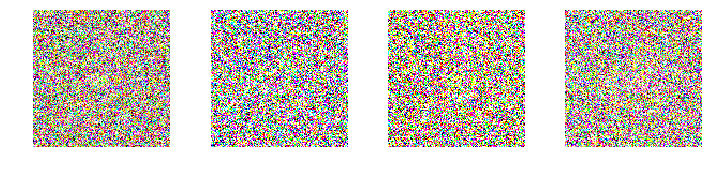

epoch: 14000, [Discriminator :: d_loss: 0.034881], [ Generator :: loss: 4.491212]


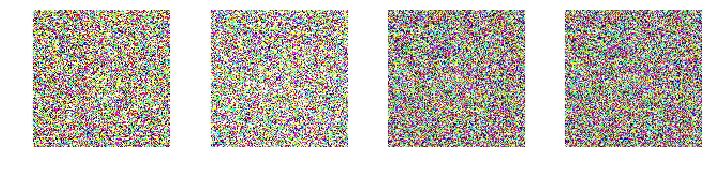

epoch: 14100, [Discriminator :: d_loss: 0.094105], [ Generator :: loss: 3.193637]


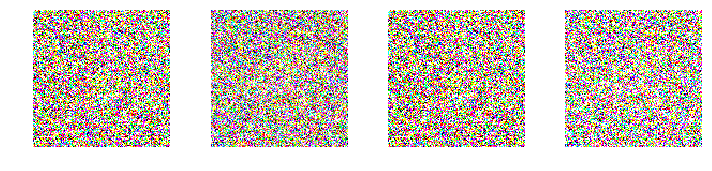

epoch: 14200, [Discriminator :: d_loss: 0.125807], [ Generator :: loss: 4.097126]


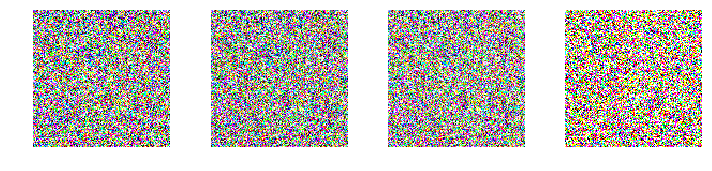

epoch: 14300, [Discriminator :: d_loss: 0.420275], [ Generator :: loss: 5.056672]


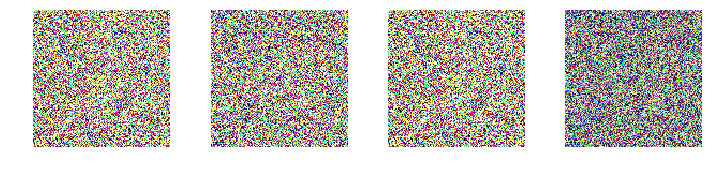

epoch: 14400, [Discriminator :: d_loss: 0.239765], [ Generator :: loss: 4.345418]


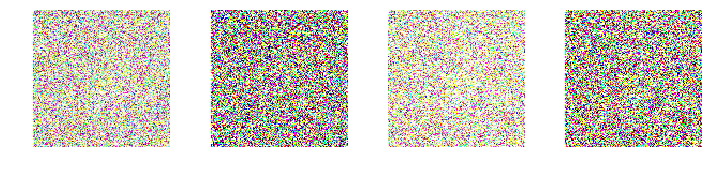

epoch: 14500, [Discriminator :: d_loss: 1.526993], [ Generator :: loss: 6.471511]


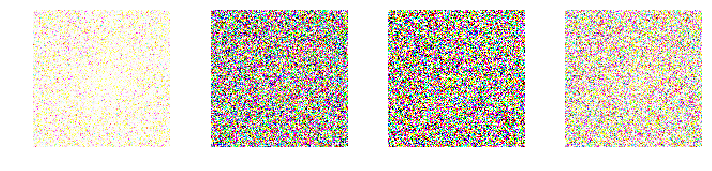

epoch: 14600, [Discriminator :: d_loss: 0.633559], [ Generator :: loss: 4.513824]


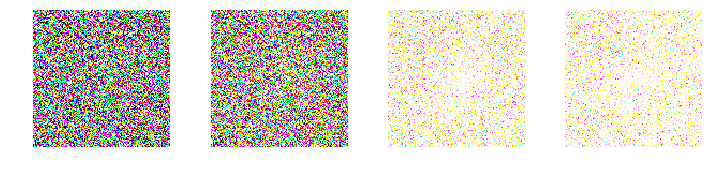

epoch: 14700, [Discriminator :: d_loss: 0.218138], [ Generator :: loss: 5.563369]


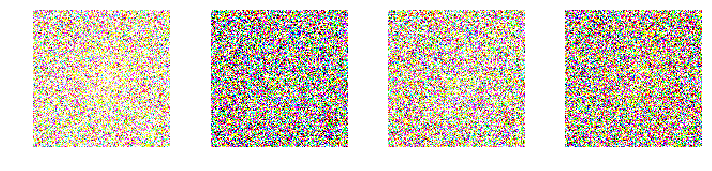

epoch: 14800, [Discriminator :: d_loss: 0.142048], [ Generator :: loss: 5.546897]


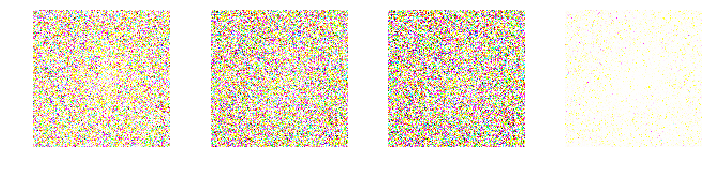

epoch: 14900, [Discriminator :: d_loss: 0.650054], [ Generator :: loss: 7.859084]


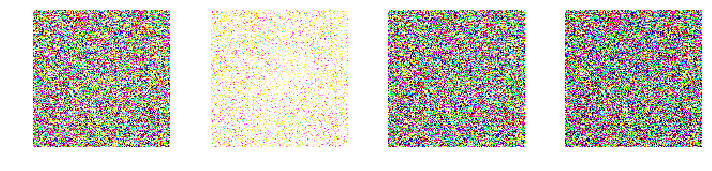

epoch: 15000, [Discriminator :: d_loss: 0.490454], [ Generator :: loss: 7.703009]


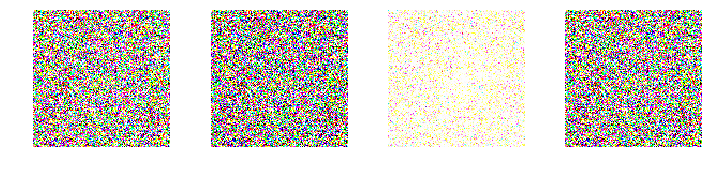

epoch: 15100, [Discriminator :: d_loss: 0.445054], [ Generator :: loss: 7.185730]


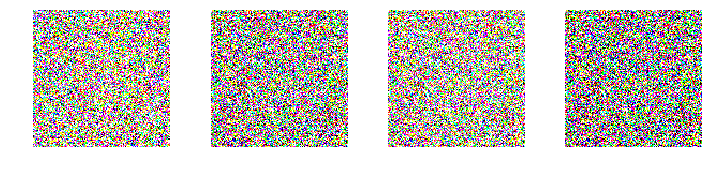

epoch: 15200, [Discriminator :: d_loss: 0.265448], [ Generator :: loss: 8.996637]


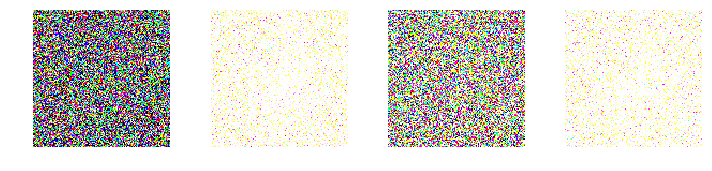

epoch: 15300, [Discriminator :: d_loss: 0.319488], [ Generator :: loss: 7.725454]


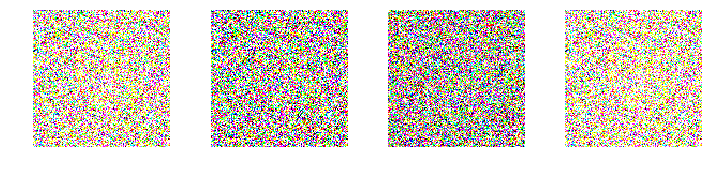

epoch: 15400, [Discriminator :: d_loss: 0.148028], [ Generator :: loss: 2.993254]


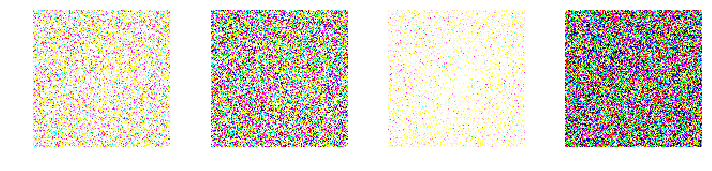

epoch: 15500, [Discriminator :: d_loss: 0.231479], [ Generator :: loss: 7.345687]


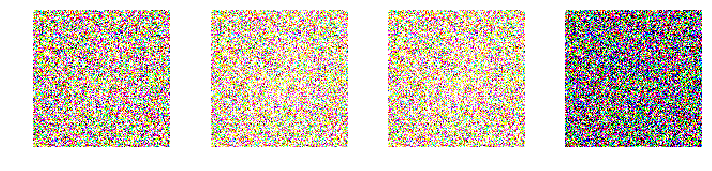

epoch: 15600, [Discriminator :: d_loss: 0.469940], [ Generator :: loss: 5.974805]


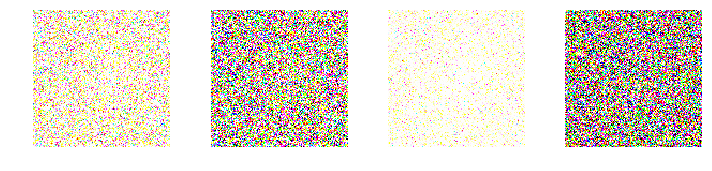

epoch: 15700, [Discriminator :: d_loss: 0.228768], [ Generator :: loss: 4.566148]


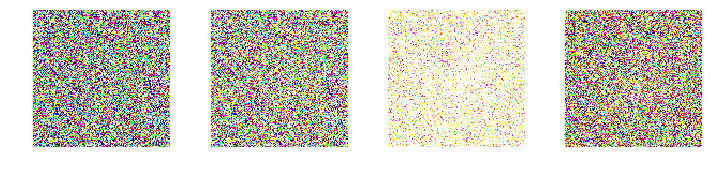

epoch: 15800, [Discriminator :: d_loss: 0.372645], [ Generator :: loss: 4.568786]


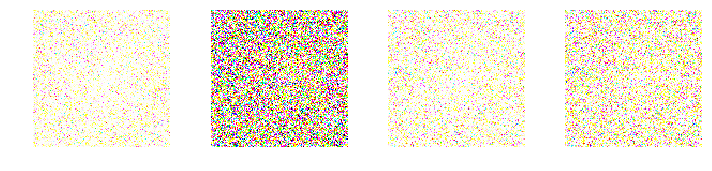

epoch: 15900, [Discriminator :: d_loss: 0.086841], [ Generator :: loss: 4.462756]


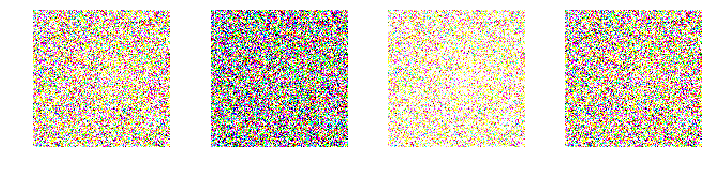

epoch: 16000, [Discriminator :: d_loss: 0.313264], [ Generator :: loss: 6.056600]


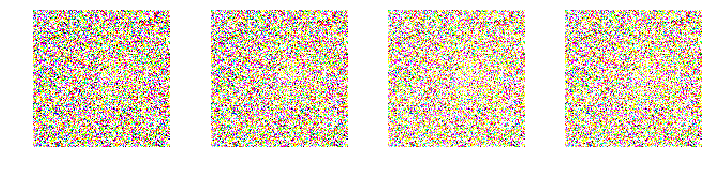

epoch: 16100, [Discriminator :: d_loss: 0.069279], [ Generator :: loss: 3.149618]


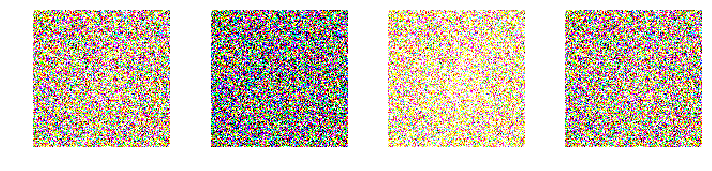

epoch: 16200, [Discriminator :: d_loss: 0.292281], [ Generator :: loss: 4.021339]


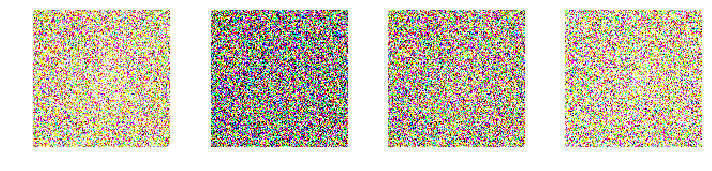

epoch: 16300, [Discriminator :: d_loss: 0.189047], [ Generator :: loss: 3.245359]


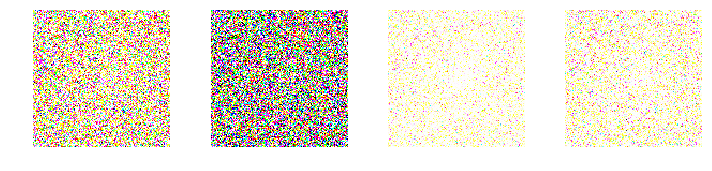

epoch: 16400, [Discriminator :: d_loss: 0.072117], [ Generator :: loss: 3.256407]


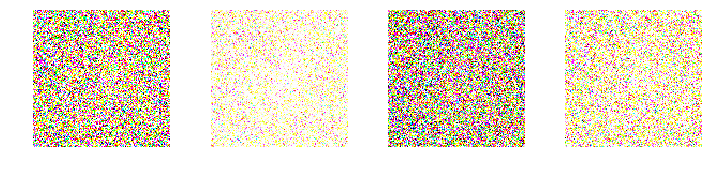

epoch: 16500, [Discriminator :: d_loss: 0.049452], [ Generator :: loss: 8.397865]


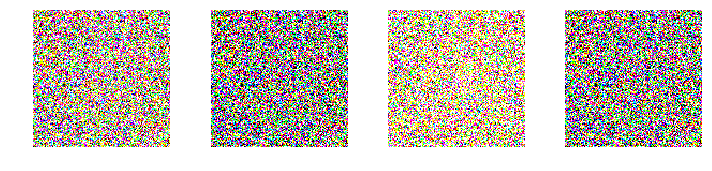

epoch: 16600, [Discriminator :: d_loss: 0.207578], [ Generator :: loss: 6.578198]


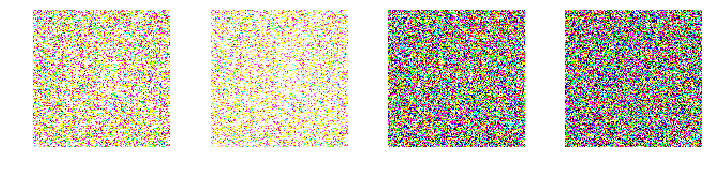

epoch: 16700, [Discriminator :: d_loss: 0.131846], [ Generator :: loss: 3.745302]


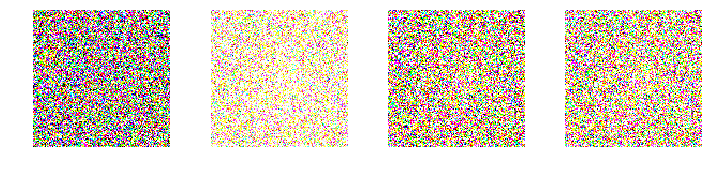

epoch: 16800, [Discriminator :: d_loss: 0.393644], [ Generator :: loss: 9.296387]


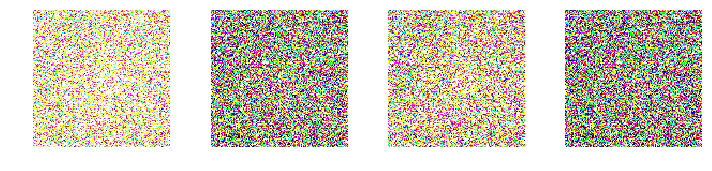

epoch: 16900, [Discriminator :: d_loss: 0.301187], [ Generator :: loss: 4.305939]


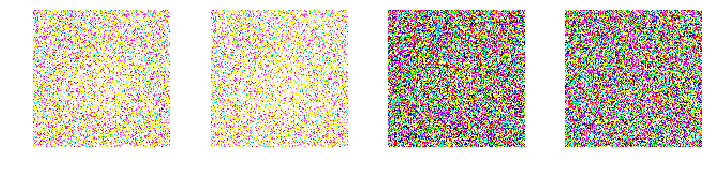

epoch: 17000, [Discriminator :: d_loss: 0.019657], [ Generator :: loss: 7.576023]


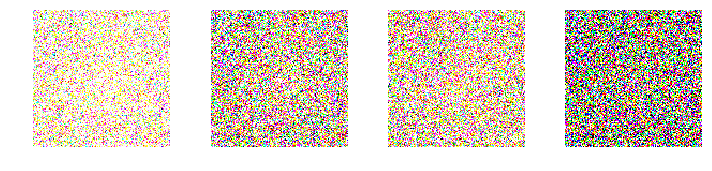

epoch: 17100, [Discriminator :: d_loss: 0.374350], [ Generator :: loss: 6.072505]


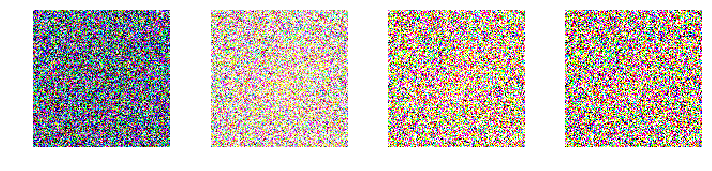

epoch: 17200, [Discriminator :: d_loss: 0.633622], [ Generator :: loss: 9.123620]


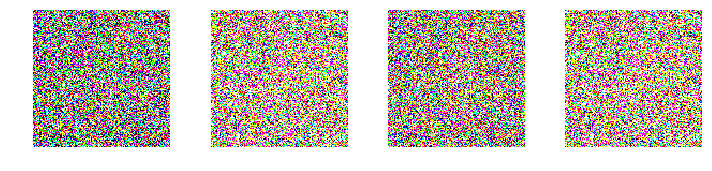

epoch: 17300, [Discriminator :: d_loss: 0.127748], [ Generator :: loss: 9.179742]


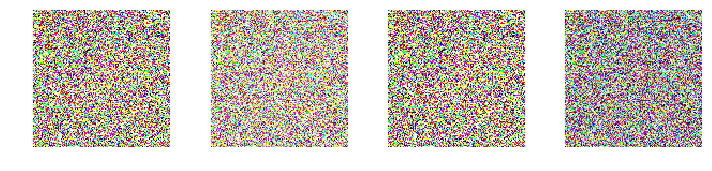

epoch: 17400, [Discriminator :: d_loss: 0.040675], [ Generator :: loss: 8.302101]


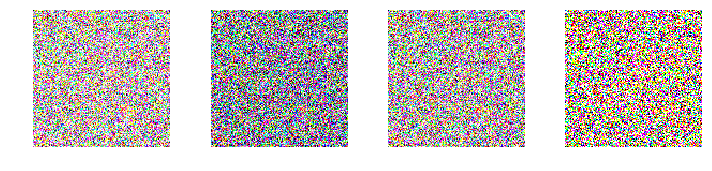

epoch: 17500, [Discriminator :: d_loss: 0.059451], [ Generator :: loss: 7.280424]


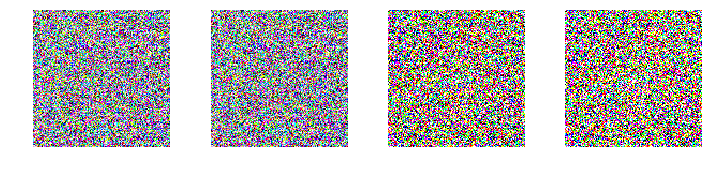

epoch: 17600, [Discriminator :: d_loss: 0.198845], [ Generator :: loss: 5.164671]


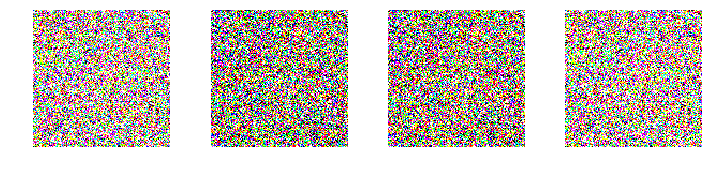

epoch: 17700, [Discriminator :: d_loss: 0.105775], [ Generator :: loss: 6.081893]


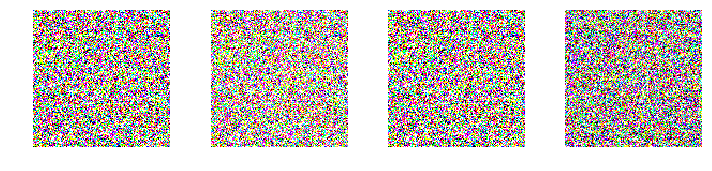

epoch: 17800, [Discriminator :: d_loss: 0.101783], [ Generator :: loss: 2.899284]


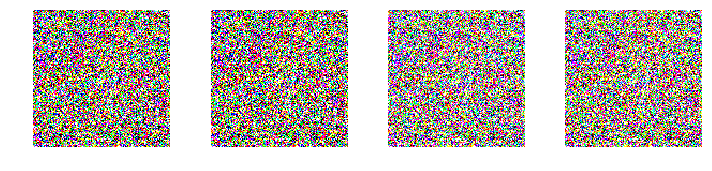

epoch: 17900, [Discriminator :: d_loss: 0.103839], [ Generator :: loss: 9.197069]


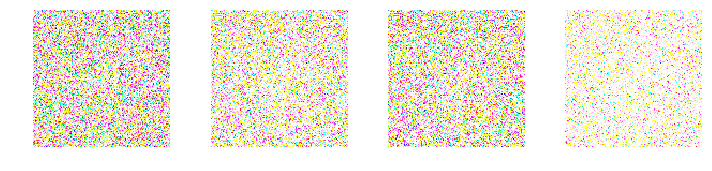

epoch: 18000, [Discriminator :: d_loss: 0.037118], [ Generator :: loss: 5.351057]


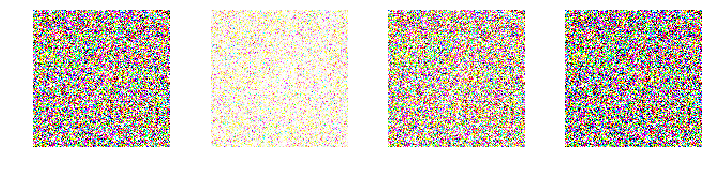

epoch: 18100, [Discriminator :: d_loss: 0.644154], [ Generator :: loss: 8.791323]


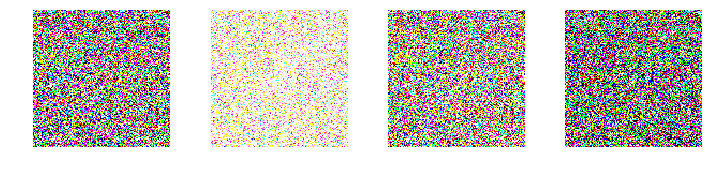

epoch: 18200, [Discriminator :: d_loss: 0.301360], [ Generator :: loss: 6.971899]


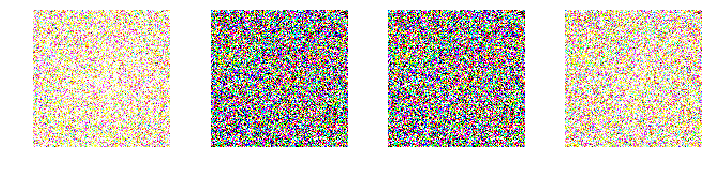

epoch: 18300, [Discriminator :: d_loss: 0.344167], [ Generator :: loss: 7.176841]


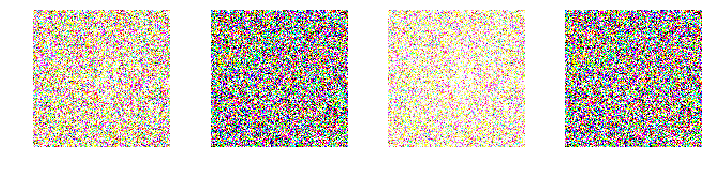

epoch: 18400, [Discriminator :: d_loss: 0.115535], [ Generator :: loss: 9.173436]


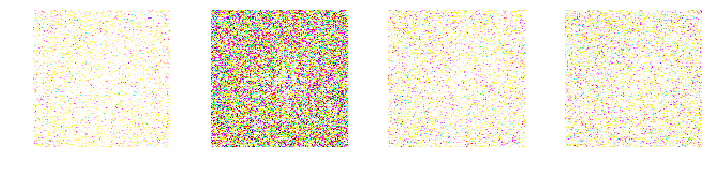

epoch: 18500, [Discriminator :: d_loss: 0.267650], [ Generator :: loss: 10.861633]


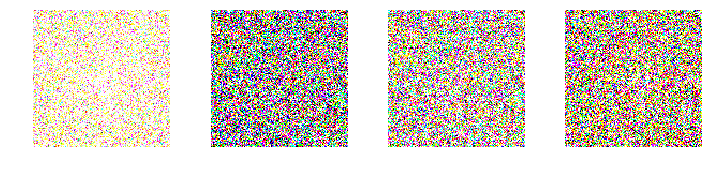

epoch: 18600, [Discriminator :: d_loss: 0.104292], [ Generator :: loss: 11.118649]


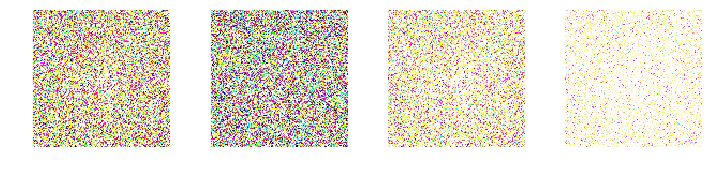

epoch: 18700, [Discriminator :: d_loss: 0.021203], [ Generator :: loss: 11.549706]


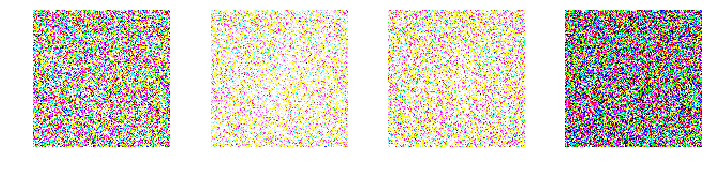

epoch: 18800, [Discriminator :: d_loss: 0.389059], [ Generator :: loss: 5.952752]


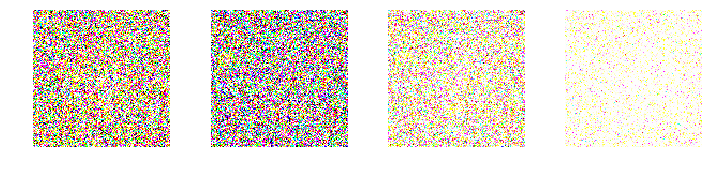

epoch: 18900, [Discriminator :: d_loss: 0.108869], [ Generator :: loss: 4.654889]


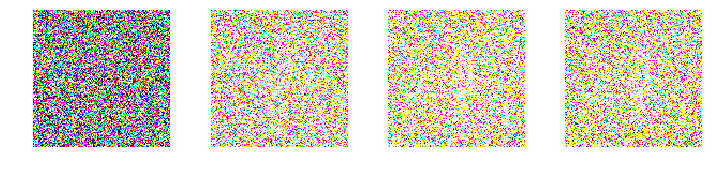

epoch: 19000, [Discriminator :: d_loss: 0.138366], [ Generator :: loss: 3.986965]


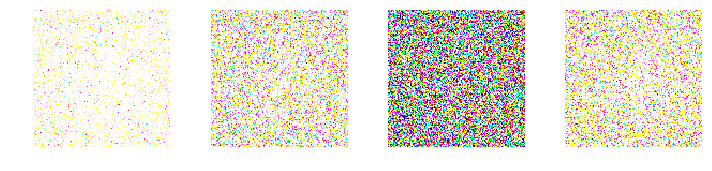

epoch: 19100, [Discriminator :: d_loss: 0.116660], [ Generator :: loss: 4.257633]


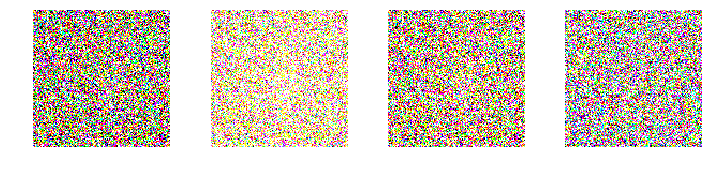

epoch: 19200, [Discriminator :: d_loss: 0.061163], [ Generator :: loss: 4.700962]


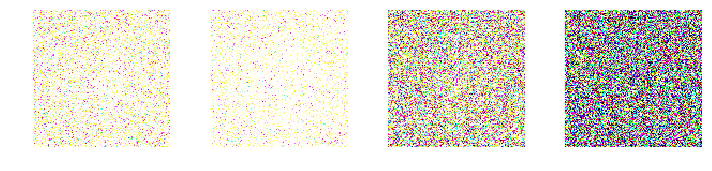

epoch: 19300, [Discriminator :: d_loss: 0.040963], [ Generator :: loss: 5.498870]


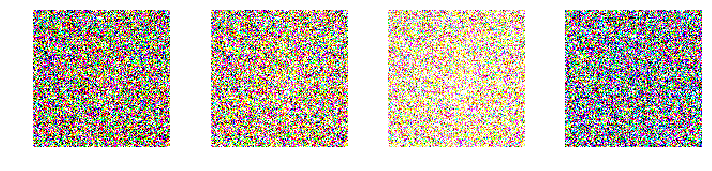

epoch: 19400, [Discriminator :: d_loss: 0.087328], [ Generator :: loss: 3.431180]


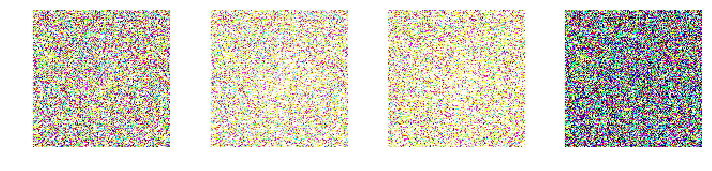

epoch: 19500, [Discriminator :: d_loss: 0.109407], [ Generator :: loss: 5.386760]


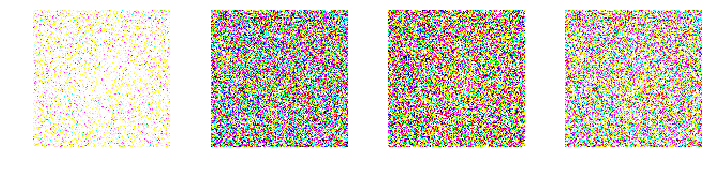

epoch: 19600, [Discriminator :: d_loss: 0.054043], [ Generator :: loss: 8.227856]


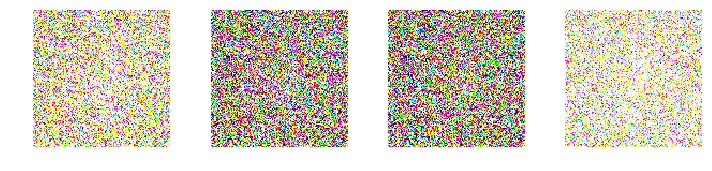

epoch: 19700, [Discriminator :: d_loss: 0.040356], [ Generator :: loss: 6.270081]


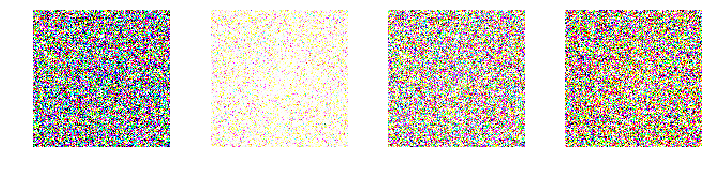

epoch: 19800, [Discriminator :: d_loss: 0.039453], [ Generator :: loss: 6.353951]


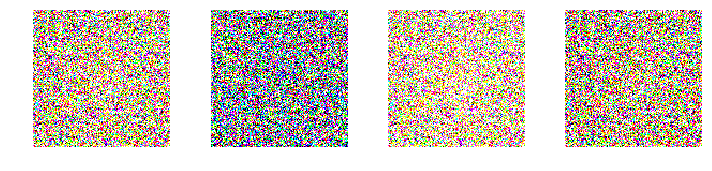

epoch: 19900, [Discriminator :: d_loss: 0.072136], [ Generator :: loss: 4.952656]


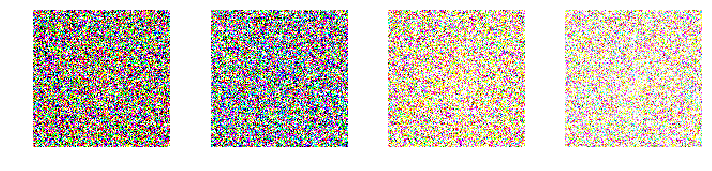

epoch: 19999, [Discriminator :: d_loss: 0.044682], [ Generator :: loss: 5.361739]


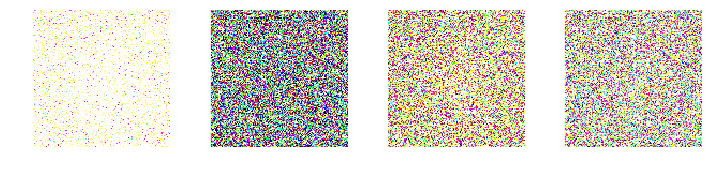

In [53]:
gan.train(XTRAIN,epochs=20000)

In [19]:
%ls

1erNovembre2.csv      2NovembreBesac.csv    mix.csv
1erNovembre3.csv      ChallengeIA.ipynb     model/
2018-11-02 16:41.csv  README.md             model.png
2018-11-03 18:09.csv  data_airbus_defi/     model_plot.png
2018-11-05 16:18.csv  essais.ipynb


In [20]:
liste = [#"1erNovembre2.csv",
#"1erNovembre3.csv",
"2018-11-02 16:41.csv",
"2NovembreBesac.csv",
"2018-11-05 16:18.csv"]

In [21]:
pds = []
for l in liste:
    pds.append(pd.read_csv(l, sep = ";"))

In [22]:
def cut_half(x):
    if x < .5:
        return 0
    else:
        return 1
pred = list((pds[0]["prediction"] + pds[1]["prediction"] + pds[2]["prediction"])/3)
prediction = [cut_half(x) for x in pred]

In [23]:
pds[0]["prediction"] = prediction
p =pds[0]

In [24]:
p.set_index("name", inplace=True)

In [25]:
p.to_csv("mix5-11.csv",sep=";")

In [28]:
def windmill_model(x_train, y_train, x_val, y_val, params):

    conv2Dsize = 12
    pool_size = (2,2)
    
    modelBW = Sequential()
    modelBW.add(Conv2D(conv2Dsize, (4,4), input_shape = input_shape, activation = params['activation']))
    modelBW.add(Conv2D(12, pool_size, activation = params['activation']))
    modelBW.add(Conv2D( 6, (2,2), activation = 'relu'))
    modelBW.add(MaxPooling2D(pool_size = (2,2)))
    modelBW.add(Dropout(params['dropout']))
    modelBW.add(Conv2D(conv2Dsize, (3, 3), activation = 'relu'))
    modelBW.add(MaxPooling2D(pool_size = pool_size))
    modelBW.add(Dropout(params['dropout']))
    modelBW.add(Flatten())
    modelBW.add(Dense(units = params["hidden_layers"], activation = 'sigmoid'))
    modelBW.add(Dense(units = 1, activation = 'sigmoid'))

    modelBW.compile(loss=params['losses'],
                  optimizer=params['optimizer'],
                  metrics=['acc'])    # next we can build the model exactly like we would normally do it

    
    history = modelBW.fit(x_train, y_train, 
                        validation_split=.1,
                        batch_size=params['batch_size'],
                        epochs=params['epochs'],
                        verbose=0)
    
    # finally we have to make sure that history object and model are returned
    return history, model

In [29]:
p = {'lr': (0.5, 5, 10),
     'first_neuron':[4, 8, 16, 32, 64],
     'hidden_layers':[0, 1, 2],
     'batch_size': (2, 30, 10),
     'epochs': [150],
     'dropout': (0, 0.5, 5),
     'weight_regulizer':[None],
     'emb_output_dims': [None],
     'shape':['brick','long_funnel'],
     'optimizer': ["adam", "SGD", "RMSprop"],
     'losses': ["logcosh", "binary_crossentropy"],
     'activation':["relu", "elu"],
     'last_activation': ["sigmoid"]}

In [30]:
import talos as ta
t = ta.Scan(x=XTRAIN,
            y=train_labels,
            model=windmill_model,
            grid_downsample=0.01, 
            params=p,
            dataset_name='breast_cancer',
            experiment_no='1')







  0%|          | 0/1800 [00:00<?, ?it/s]

NameError: name 'model' is not defined

In [19]:
128 * 128 * 3

49152

## Tensorboard

In [41]:
EPOCHS = 2
BATCH_SIZE = 200
PATIENCE = 10
early_stopping = EarlyStopping(monitor='loss', min_delta=0, patience=PATIENCE, verbose=0, mode='auto')

In [42]:
PATIENCE = 10
early_stopping = EarlyStopping(monitor='loss', min_delta=0, patience=PATIENCE, verbose=0, mode='auto')
LOG_DIRECTORY_ROOT = ''
now = datetime.utcnow().strftime("%Y%m%d%H%M%S")
log_dir = "TF" + now
tensorboard = TensorBoard(log_dir=log_dir, write_graph=True, write_images=True)
callbacks = [early_stopping, tensorboard]

In [44]:
model.fit(XTRAIN, train_labels, epochs=EPOCHS, batch_size=BATCH_SIZE, callbacks=callbacks, verbose=0)

In [45]:
now

'20181103094232'

In [ ]:
## tensorboard --logdir TF2018......